# Compare ref test run at CDP to EZERO_all simulation

<mark>run with EZERO turned on in src/energBalNoVegSolve.f90 and src/energBalVegSolve.f90 (added in QSENSG)</mark>

After identifying a cold bias in the reference simulation during the night time, I tested to activate back the EZERO term in the computation of the sensible heat flux. See detail bellow:

I've just pointed out on the figure attached a cold skin snow surface temperature bias at night time during stable conditions (red line : observations / black line : model), which leads to an actual overall cold surface bias of a little less than 5°C in average on the snow season; which was already pointed out in Brown et al. ([2006](https://doi.org/10.3137/ao.440302)):

>*"At both mountain sites (CDP and WFJ) CLASS exhibited a marked night-time cold bias, averaging 2°–4°C under stable conditions. The bias was found to be closely linked to atmospheric stability and was not present under neutral conditions. Comparisons with other snow models indicated that this cold bias was likely related to an underestimation of the sensible heat flux on the order of 20–40 W m–2 during stable conditions. The inclusion of a windless transfer coefficient in the computation of QH , following Essery and Etchevers (2004), accounted for a significant fraction of the energy deficit during highly stable conditions, and reduced the average night-time bias to less than 1°C at WFJ. It should be noted that this correction has been used in several multi-layer physical snowpack models for some time (e.g., SNTHERM and CROCUS) and is one reason these models have shown superior performance in model intercomparisons."*

And I have noticed that in `src/energBalNoVegSolve.f90` (and Veg) they added this windless transfer coefficient `EZERO` to "to prevent the sensible heat flux over snow packs from becoming vanishingly small under highly stable conditions". However, it was kept as optional and is set to 0 in the current version.

![image](t__l__chargement_720.png)

**Libo's tests:**

![image](EZERO_libo_spatial_SL12.png)

worse biases in SnowMIP in surface temperature (https://journals.ametsoc.org/view/journals/bams/102/1/BAMS-D-19-0329.1.xml):

![image](menard_surface_bias.png)


In [1]:
# Env: sc2_v0
import xarray as xr
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy import stats
import xesmf as xe # For regridding (https://xesmf.readthedocs.io/en/latest/)
import calendar
import os

In [2]:
path = '/home/lalandmi/eccc/classic-develop/outputFiles/SnowMIP/FR-Cdp_test/run'
path2 = '/home/lalandmi/eccc/classic-develop/outputFiles/SnowMIP/FR-Cdp_test/run_EZERO_all'

label = 'run'
ds_yr = xr.open_mfdataset(path+'/*_annually.nc').load()
ds_mo = xr.open_mfdataset(path+'/*_monthly.nc').load()
ds_d = xr.open_mfdataset(path+'/*_daily.nc').load()
ds_hh = xr.open_mfdataset(path+'/*_halfhourly.nc').load()

label2 = 'run_EZERO_all'
ds2_mo = xr.open_mfdataset(path2+'/*_monthly.nc').load()
ds2_d = xr.open_mfdataset(path2+'/*_daily.nc').load()
ds2_hh = xr.open_mfdataset(path2+'/*_halfhourly.nc').load()

Text(0.5, 0.98, 'Run Col de Porte (1995-2013)')

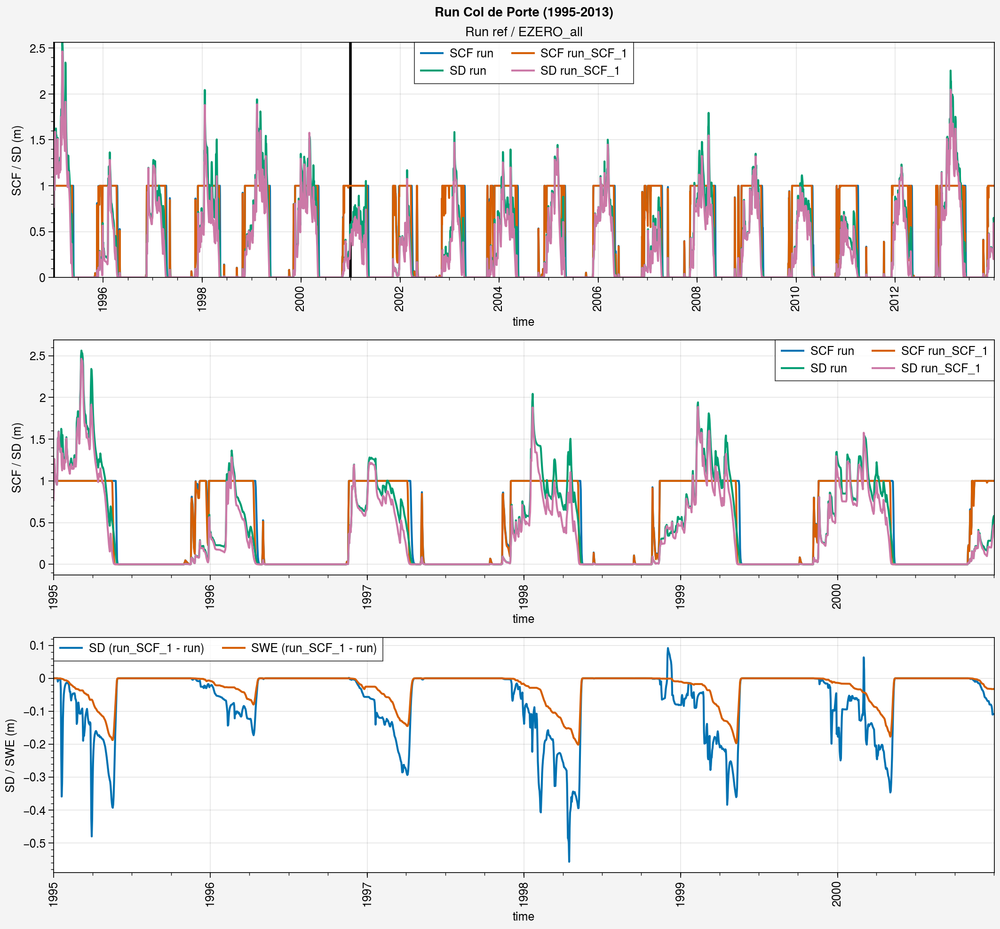

In [4]:
fig, axs = pplt.subplots(ncols=1, nrows=3, refaspect=4, refwidth=10, share=0)

##################
### All period ###
##################
start = '1995'
end = '2013'

axs[0].plot(ds_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label)
axs[0].plot(ds2_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label2)
axs[0].plot(ds_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label)
axs[0].plot(ds2_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label2)

axs[0].legend(ncols=2)
axs[0].format(
    title='Run ref / EZERO_all',
    ylabel='SCF / SD (m)'
)


############
### Zoom ###
############
start = '1995'
end = '2000'

axs[1].plot(ds_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label)
axs[1].plot(ds2_d.snc.sel(time=slice(start,end)).squeeze(), label='SCF '+label2)
axs[1].plot(ds_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label)
axs[1].plot(ds2_d.snd.sel(time=slice(start,end)).squeeze(), label='SD '+label2)
axs[0].vlines(ds_d.sel(time=slice(start,end)).time[0], ds_d.snd.min(), ds_d.snd.max(), color='k', lw=2)
axs[0].vlines(ds_d.sel(time=slice(start,end)).time[-1], ds_d.snd.min(), ds_d.snd.max(), color='k', lw=2)

axs[1].legend(ncols=2)
axs[1].format(
    ylabel='SCF / SD (m)'
)

#####################
### SWE / SD diff ###
#####################
axs[2].plot((ds2_d-ds_d).snd.sel(time=slice(start,end)).squeeze(), label='SD ('+label2+' - '+label+')')
axs[2].plot(((ds2_d-ds_d).snw*1e-3).sel(time=slice(start,end)).squeeze(), label='SWE ('+label2+' - '+label+')')

axs[2].legend(ncols=2)
axs[2].format(
    ylabel='SD / SWE (m)'
)

fig.suptitle('Run Col de Porte (1995-2013)')


## Compare with obs

In [3]:
path_menard2019 = '/home/lalandmi/Dropbox/data/ESM-SnowMIP_all'
path_lejeune2019 = '/home/lalandmi/Dropbox/data/ESM-SnowMIP_all/CRYOBSCLIM_CDP'

ds_h_eval_menard2019 = xr.open_dataset(path_menard2019+'/obs_insitu_cdp_1994_2014.nc').load()
ds_d_eval_menard2019 = ds_h_eval_menard2019.resample(time='D').mean().load()
ds_h_eval_menard2019

<xarray.Dataset> Size: 8MB
Dimensions:   (time: 175320, sdepth: 3)
Coordinates:
  * time      (time) datetime64[ns] 1MB 1994-10-01T01:00:00 ... 2014-10-01
  * sdepth    (sdepth) float32 12B 0.1 0.2 0.5
Data variables:
    albs      (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snd_auto  (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snd_man   (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snw_auto  (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    snw_man   (time) float32 701kB nan nan nan nan nan ... nan nan nan nan nan
    ts        (time) float32 701kB 11.12 9.668 8.029 ... 7.532 7.532 8.029
    tsl       (time, sdepth) float32 2MB 11.95 12.28 12.23 ... 12.95 12.83 12.8

In [5]:
ds_h_eval_lejeune2019 = xr.open_dataset(path_lejeune2019+'/CRYOBSCLIM.CDP.2018.HourlySnow.nc').load()
# ds_d_eval_lejeune2019 = xr.open_dataset(path_lejeune2019+'/CRYOBSCLIM.CDP.2018.MetSnowDaily.nc')
ds_d_eval_lejeune2019 = ds_h_eval_lejeune2019.resample(time='D').mean().load()
ds_h_eval_lejeune2019

<xarray.Dataset>
Dimensions:                   (time: 254208)
Coordinates:
  * time                      (time) datetime64[ns] 1993-08-01 ... 2022-07-31...
Data variables: (12/70)
    Soil_temperature_10cm     (time) float64 289.9 289.7 289.5 ... 292.2 291.9
    Soil_temperature_20cm     (time) float64 290.1 290.0 289.9 ... 291.6 291.6
    Soil_temperature_50cm     (time) float64 288.6 288.6 288.7 ... 290.1 290.2
    Runoff_5m2                (time) float64 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Runoff_1m2                (time) float64 0.2 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0
    Snow_depth                (time) float64 nan nan nan nan ... 0.0 0.0 0.0 0.0
    ...                        ...
    Soil_moisture_10cm_2      (time) float64 nan nan nan ... 0.1284 0.128 0.1279
    Soil_moisture_10cm_3      (time) float64 nan nan nan ... 0.0606 0.0624
    Soil_moisture_20cm_1      (time) float64 nan nan nan ... 0.2251 0.2251 0.225
    Soil_moisture_20cm_2      (time) float64 nan nan nan ... 0.2104 0.2102 0.21
    Soil_moisture_30cm_1      (time) float64 nan nan nan ... 0.2498 0.2497
    Soil_moisture_30cm_2      (time) float64 nan nan nan ... 0.2918 0.2915
Attributes:
    history:  Thu Feb  9 11:25:20 2023: ncrcat CDP_hourly_19930801_20170731.n...
    NCO:      netCDF Operators version 4.9.1 (Homepage = http://nco.sf.net, C...

### SD

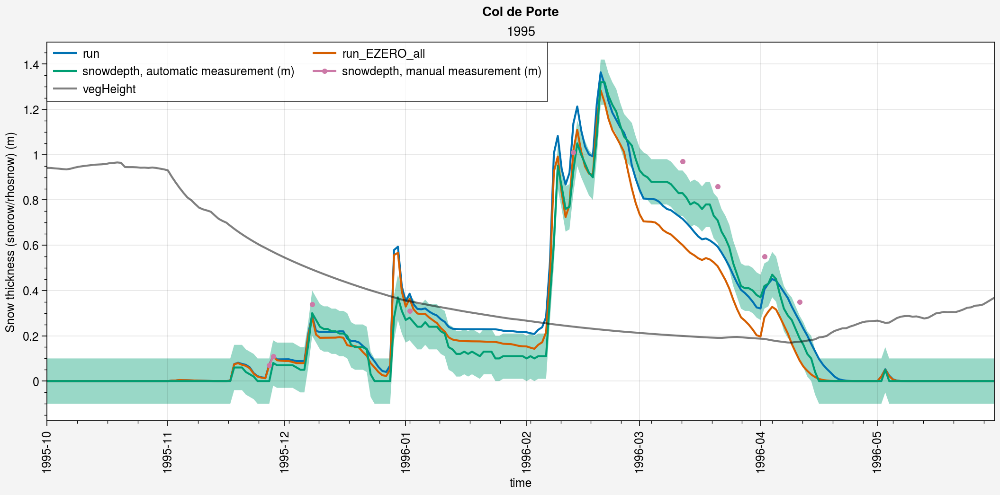

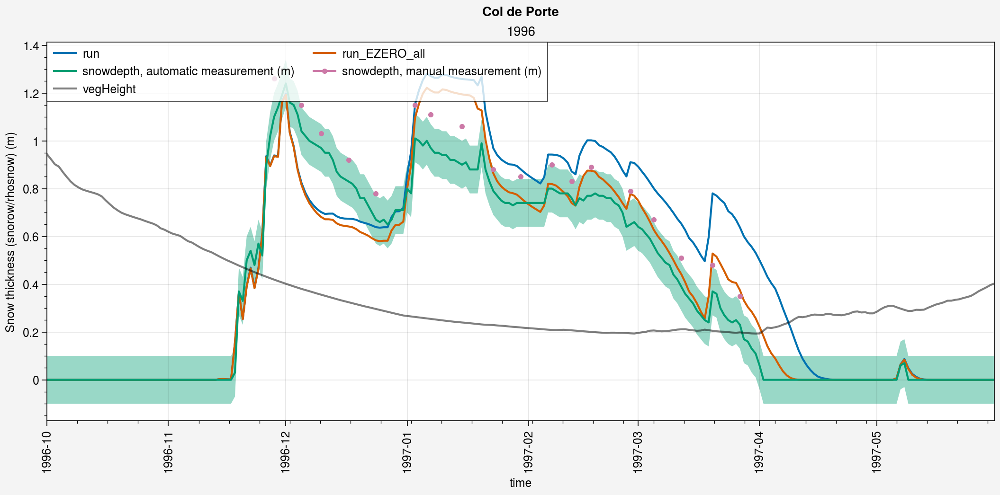

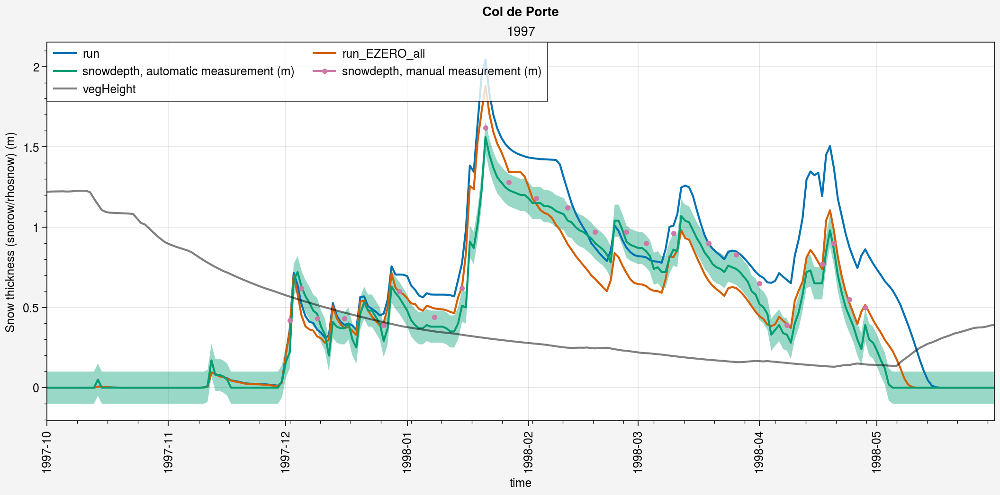

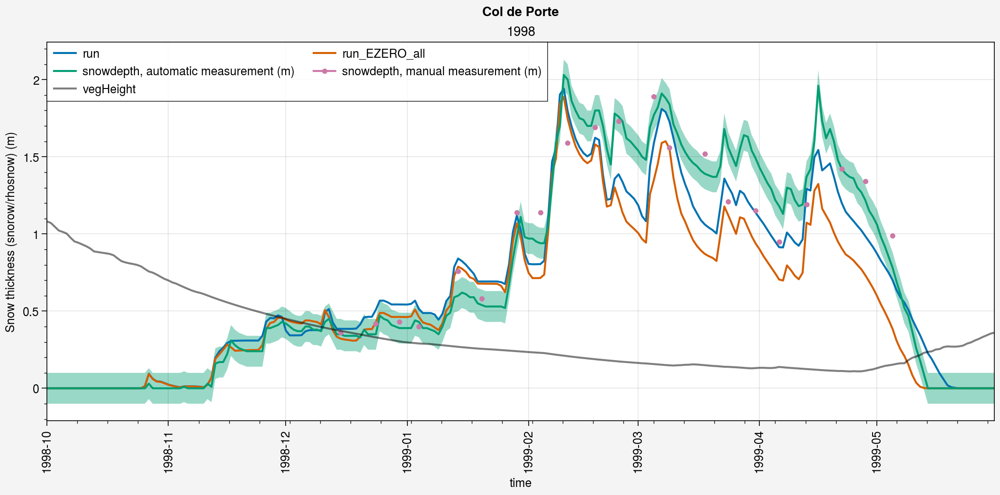

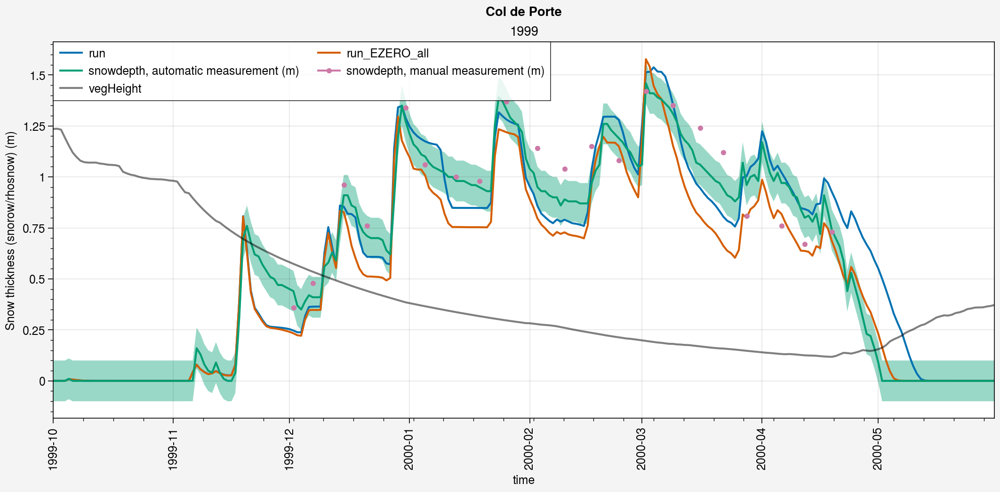

...

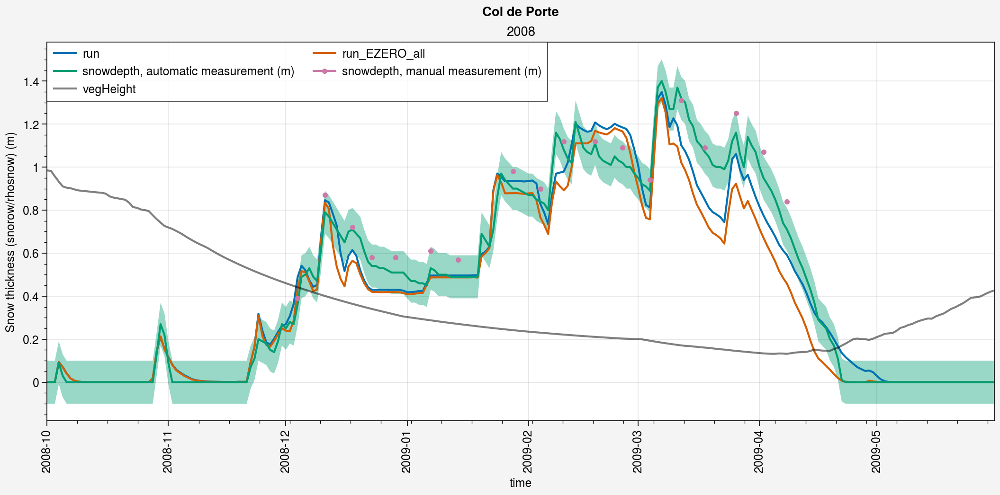

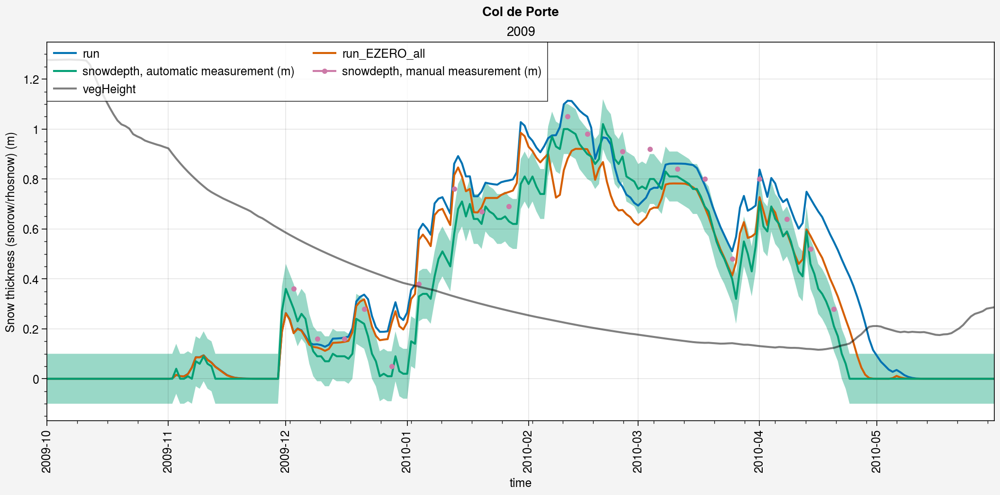

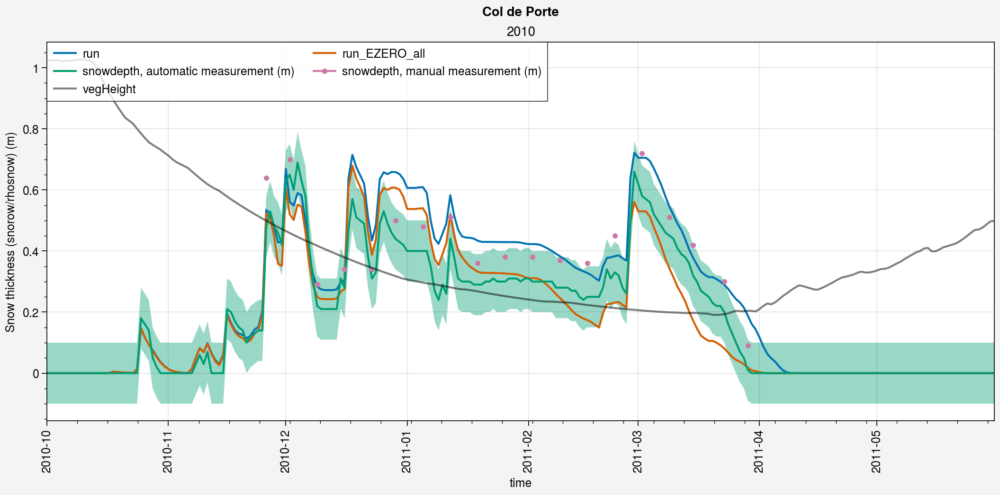

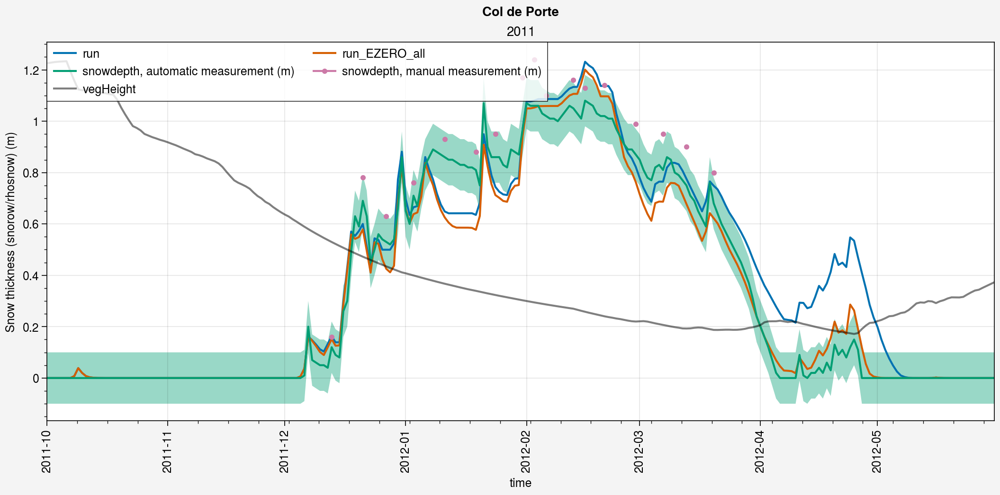

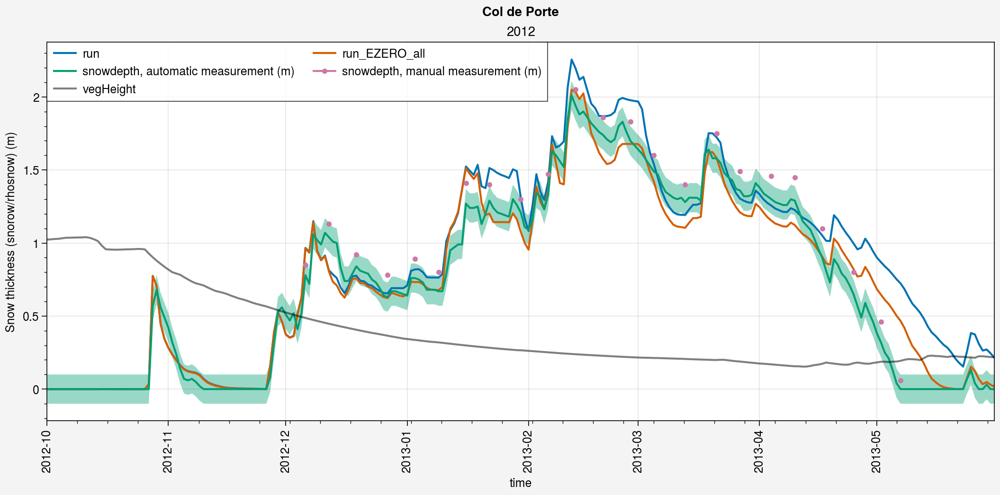

In [18]:
%matplotlib inline
for year in pplt.arange(1995, 2012):
# for year in pplt.arange(1995, 1995):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.snd.sel(time=period).squeeze(), label=label)
    axs[0].plot(ds2_d.snd.sel(time=period).squeeze(), label=label2)
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values+0.1, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snd_auto.sel(time=period).values-0.1, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snd_auto.sel(time=period), shadedata=shadedata)
    axs[0].plot(ds_d_eval_menard2019.snd_man.sel(time=period), marker='.')

    # Veg
    axs[0].plot(ds2_d.vegHeight.sel(time=period).squeeze(), label='vegHeight', color='k', alpha=0.5)
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year))
    
    fig.suptitle('Col de Porte')


### SWE

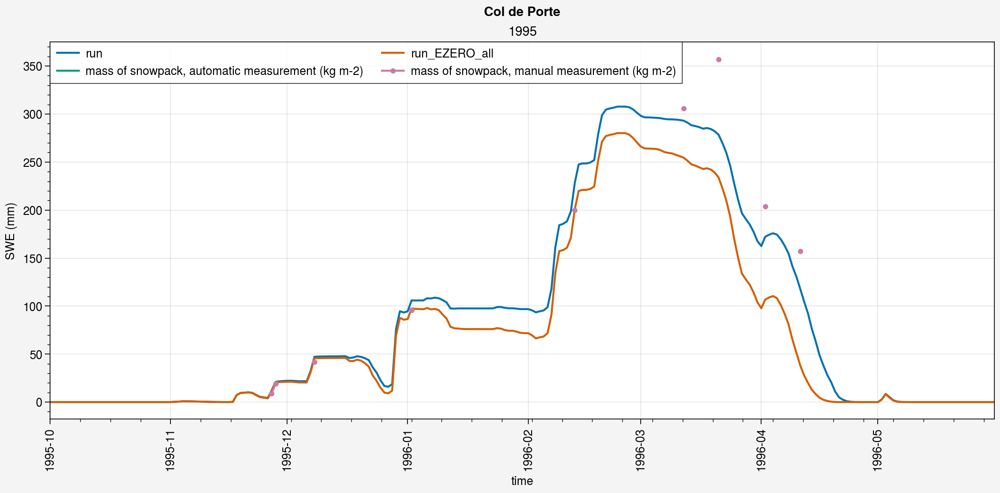

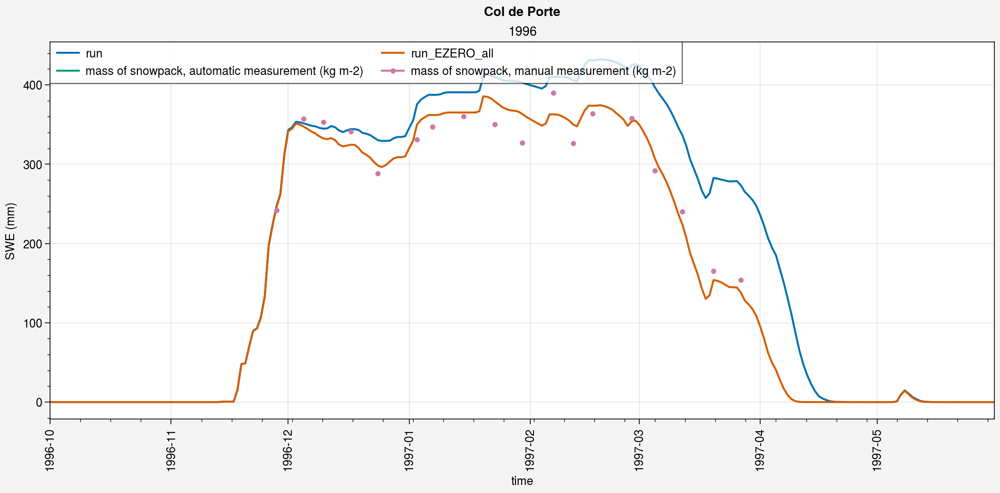

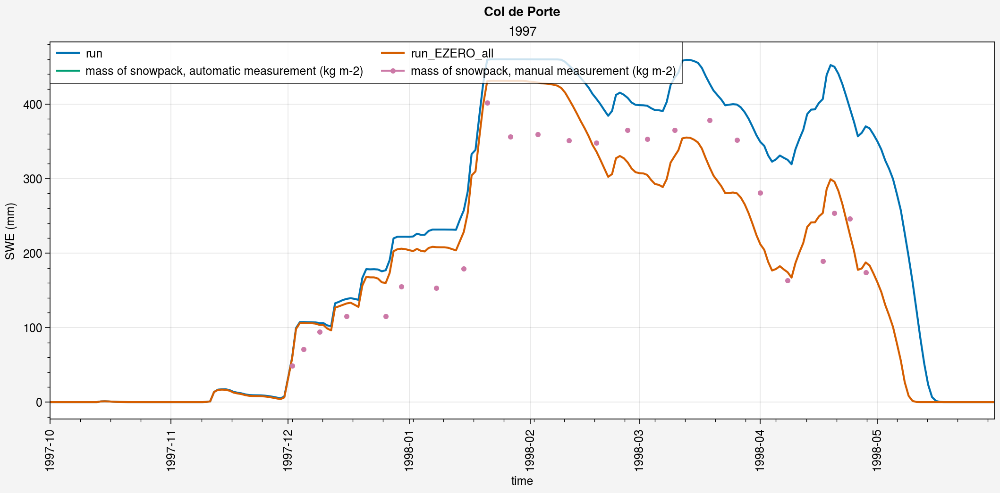

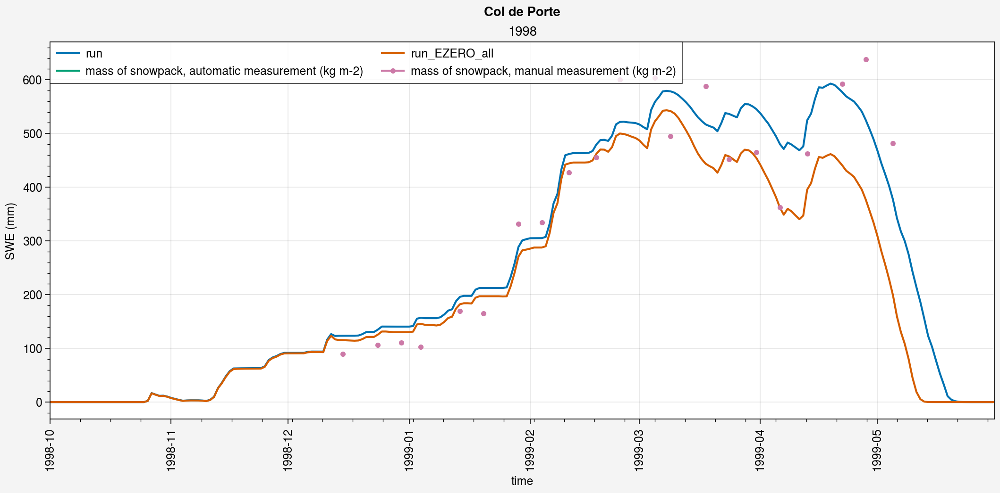

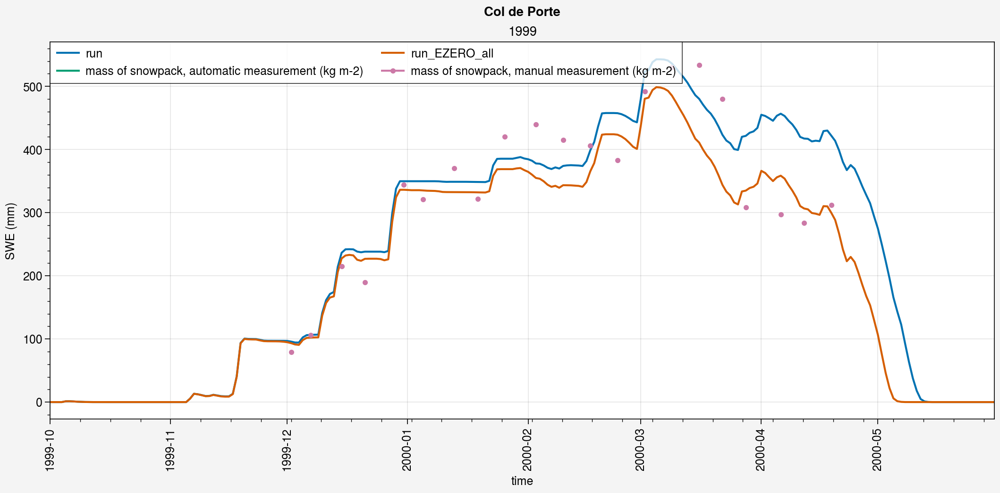

...

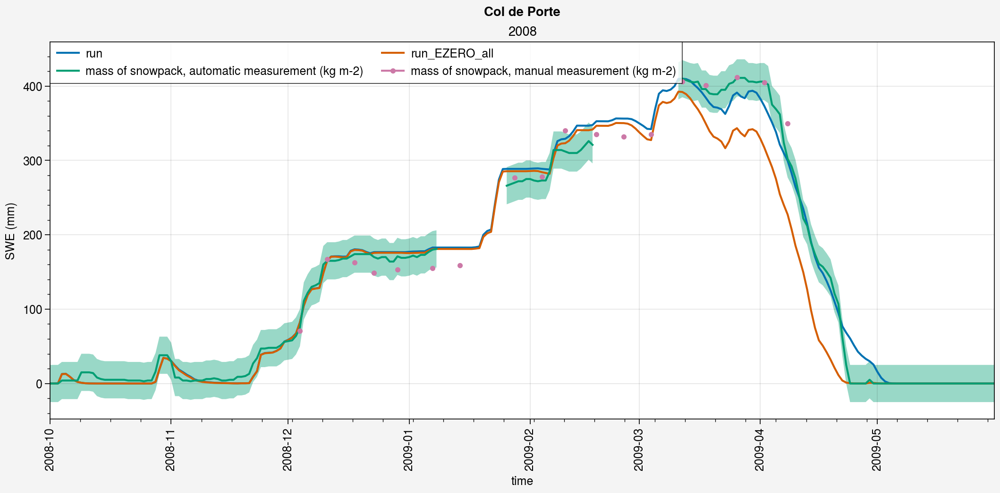

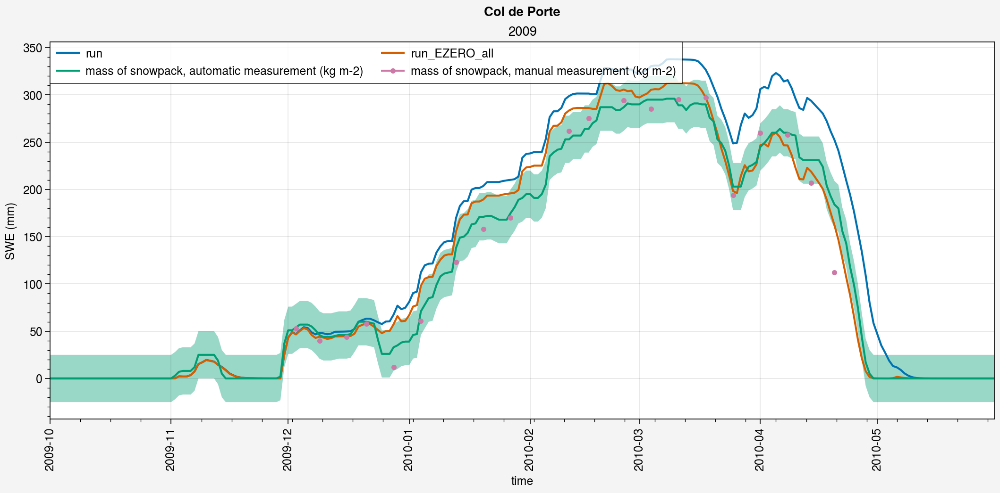

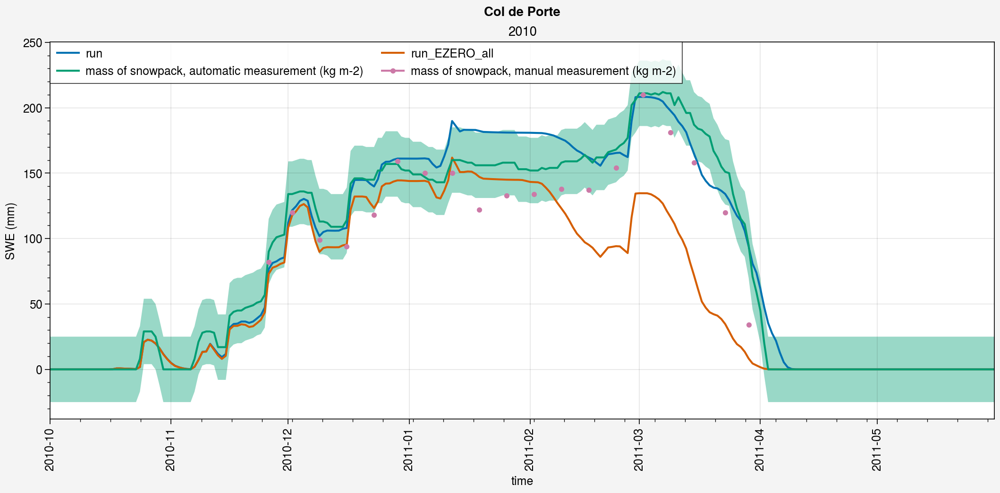

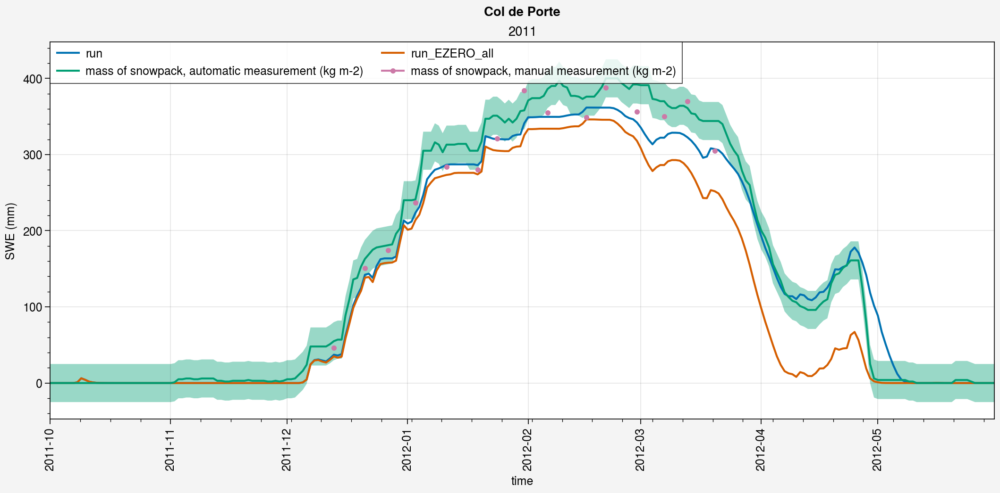

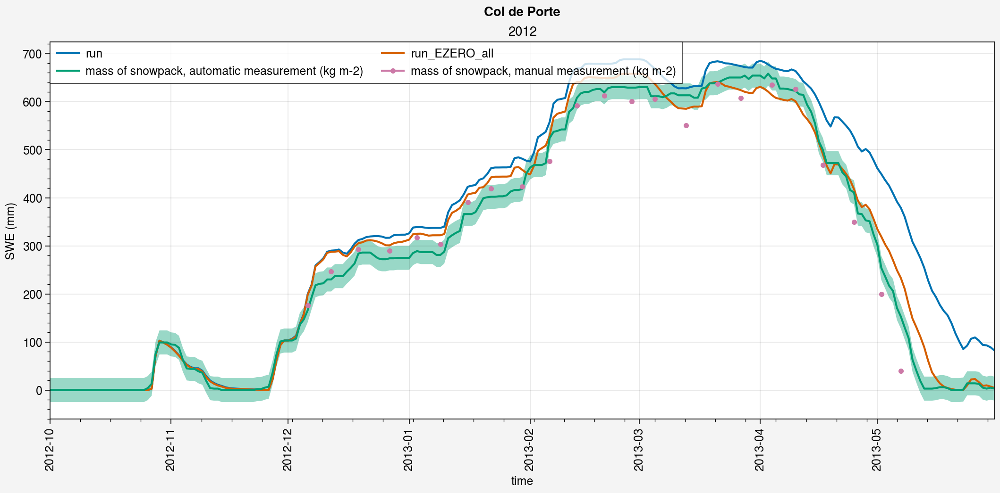

In [19]:
%matplotlib inline
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.snw.sel(time=period).squeeze(), label=label)
    axs[0].plot(ds2_d.snw.sel(time=period).squeeze(), label=label2)
    
    # Obs
    shadedata = np.concatenate((
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values+25, axis=0),
        np.expand_dims(ds_d_eval_menard2019.snw_auto.sel(time=period).values-25, axis=0),), axis=0)
    axs[0].plot(ds_d_eval_menard2019.snw_auto.sel(time=period), shadedata=shadedata)
    axs[0].plot(ds_d_eval_menard2019.snw_man.sel(time=period), marker='.')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='SWE (mm)')
    
    fig.suptitle('Col de Porte')


### Albedo

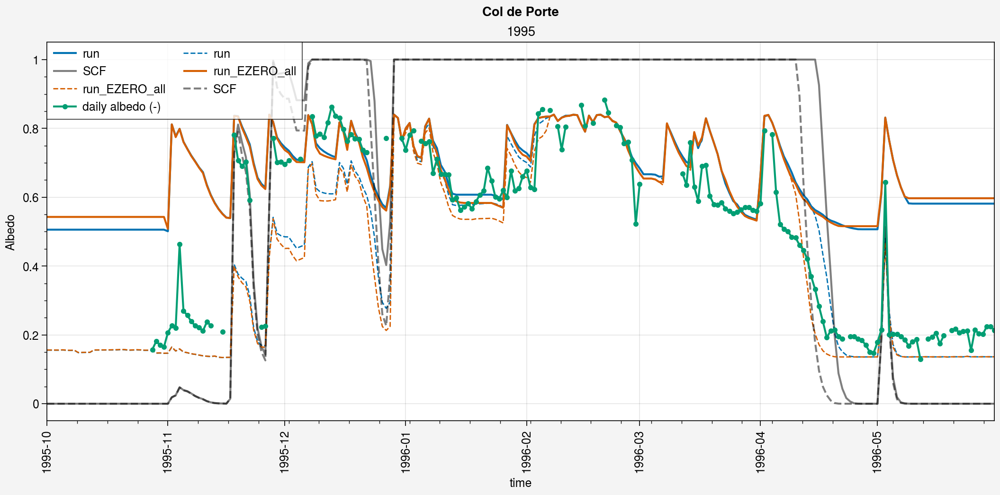

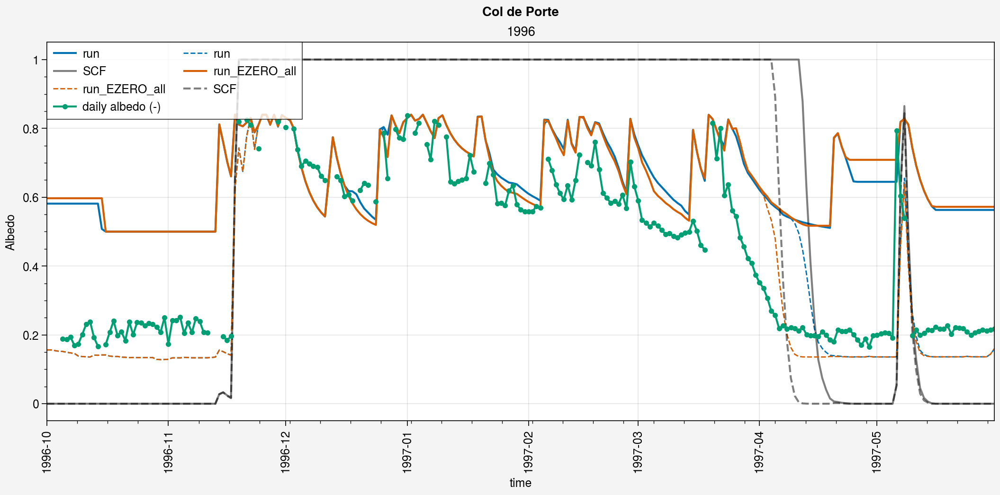

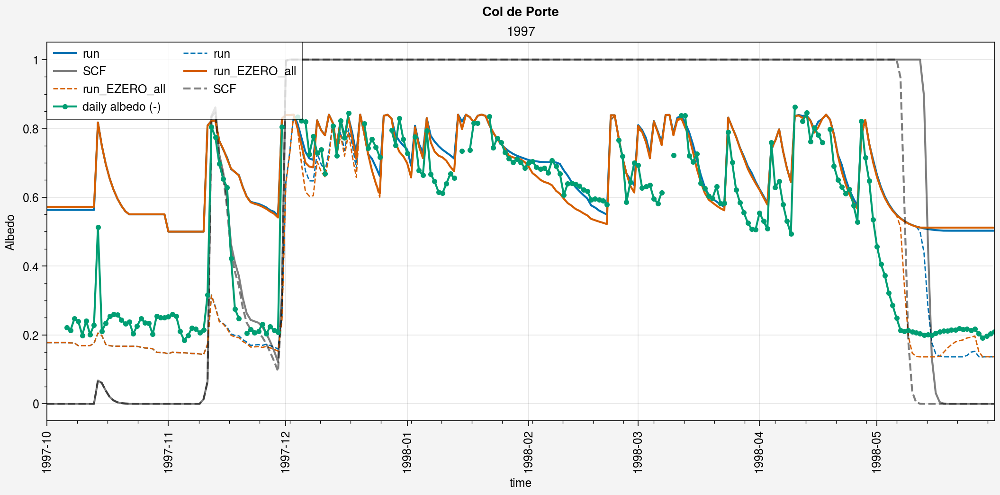

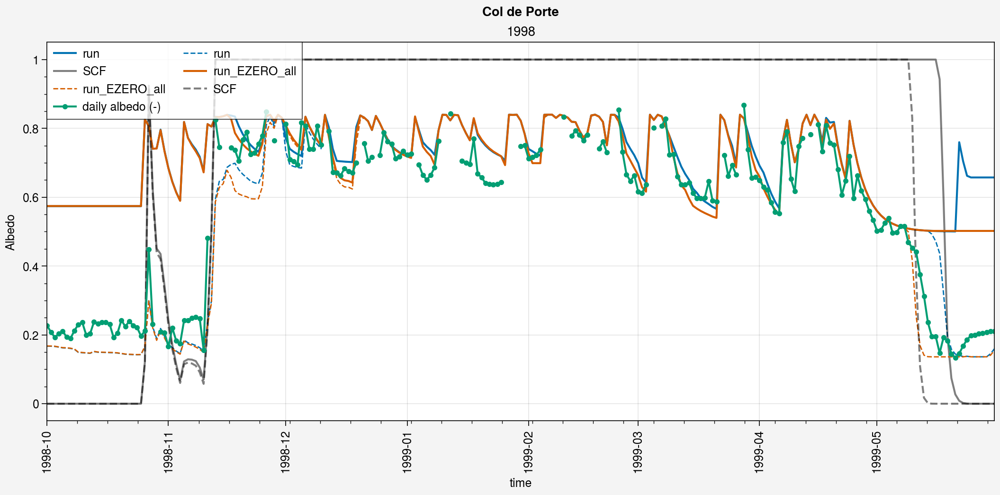

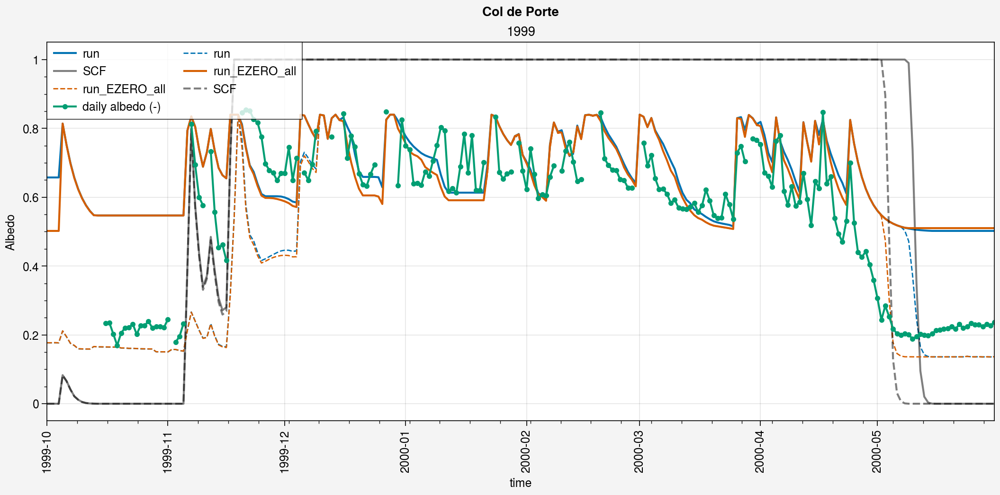

...

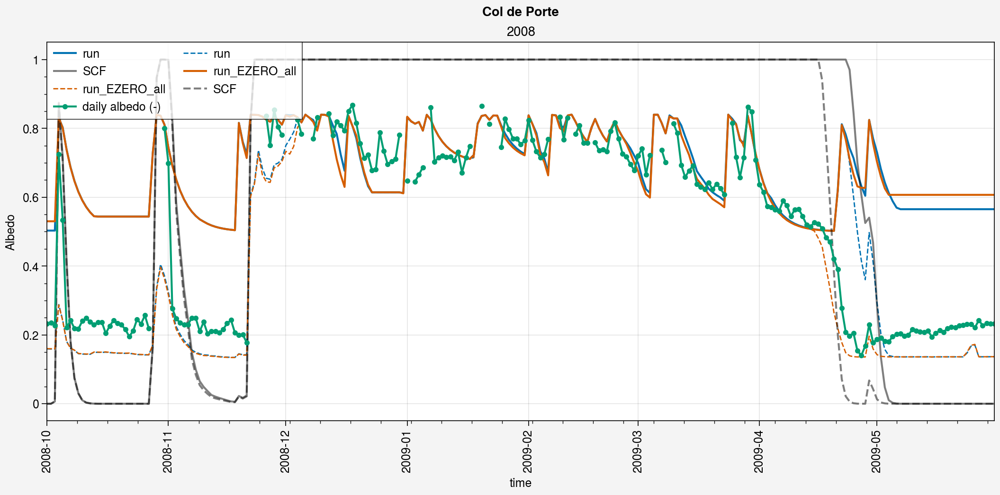

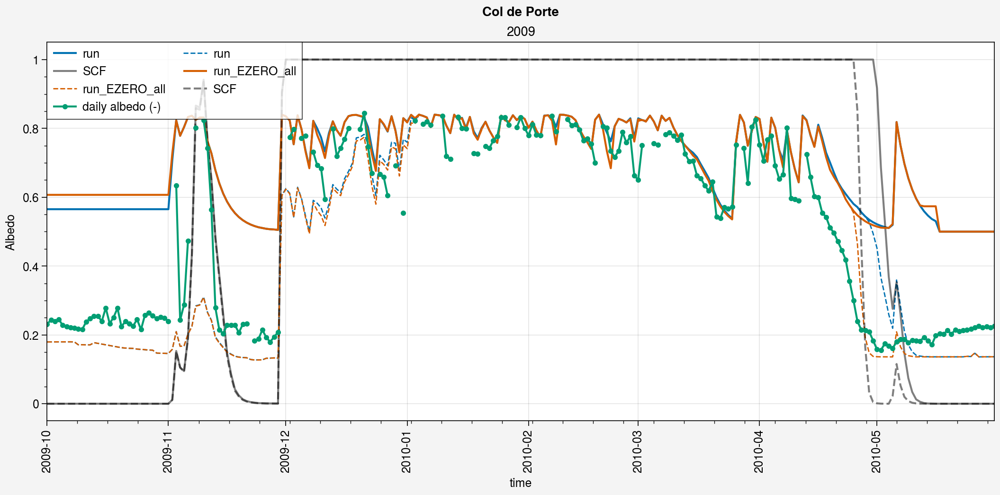

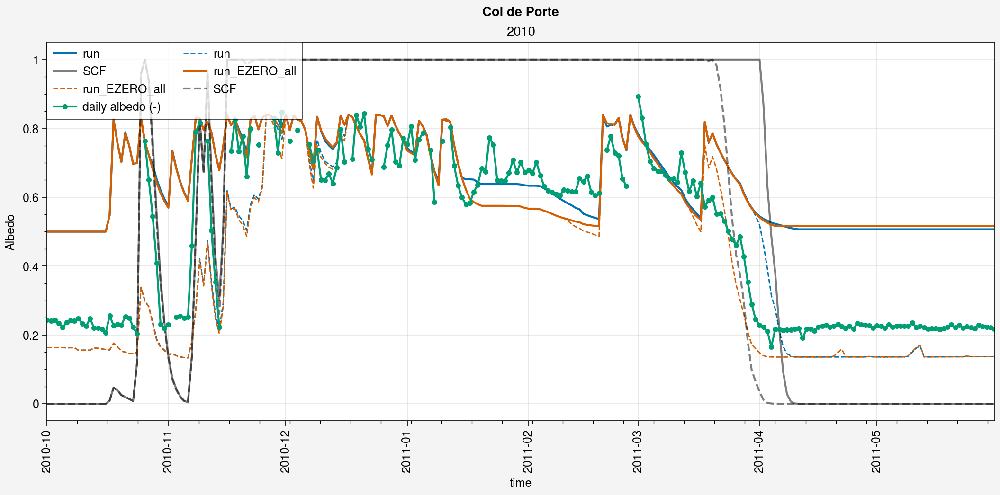

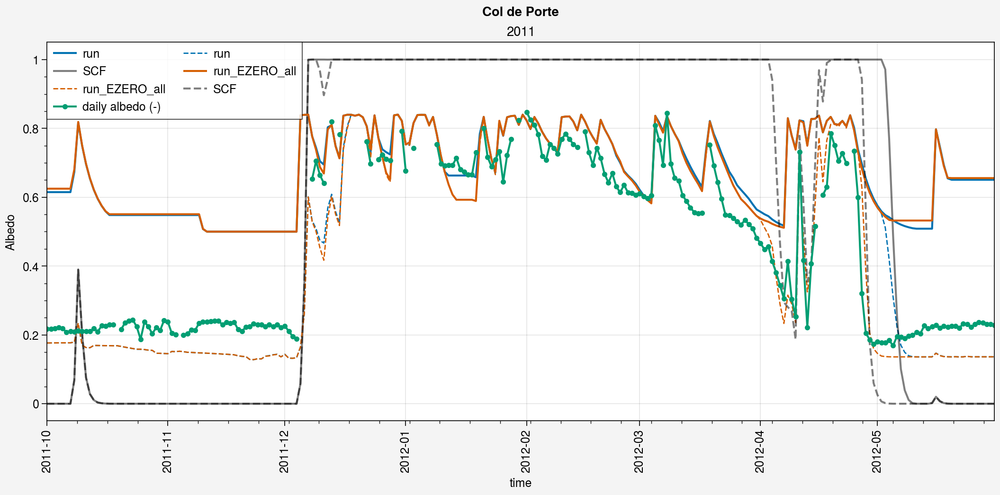

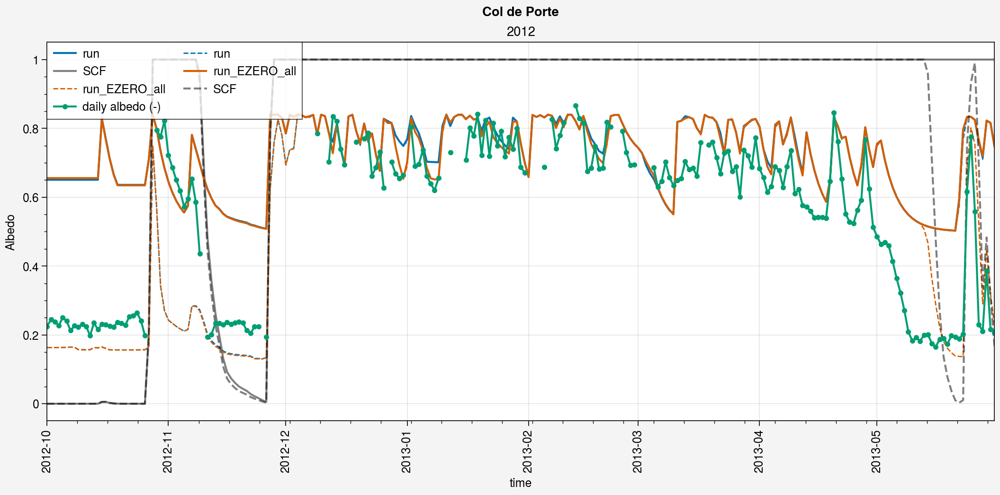

In [20]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.albsn.sel(time=period).squeeze(), label=label, color='C0')
    axs[0].plot(ds_d.albs.sel(time=period).squeeze(), label=label, color='C0', ls='--', lw=1)
    axs[0].plot(ds_d.snc.sel(time=period).squeeze(), label='SCF', color='k', alpha=0.5)
    axs[0].plot(ds2_d.albsn.sel(time=period).squeeze(), label=label2, color='C1')
    axs[0].plot(ds2_d.albs.sel(time=period).squeeze(), label=label2, color='C1', ls='--', lw=1)
    axs[0].plot(ds2_d.snc.sel(time=period).squeeze(), label='SCF', color='k', alpha=0.5, ls='--')
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.albs.sel(time=period), marker='.', color='C2')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Albedo')
    
    fig.suptitle('Col de Porte')


### Surface Temperature

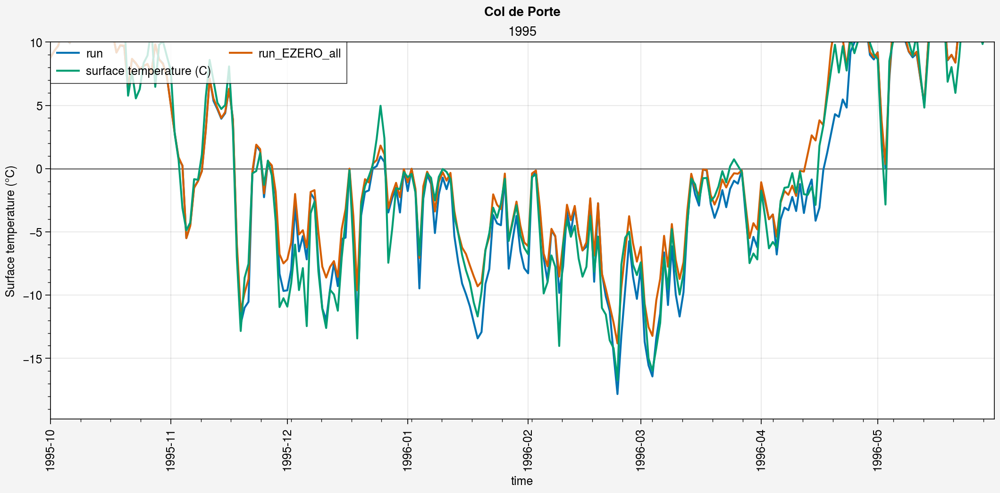

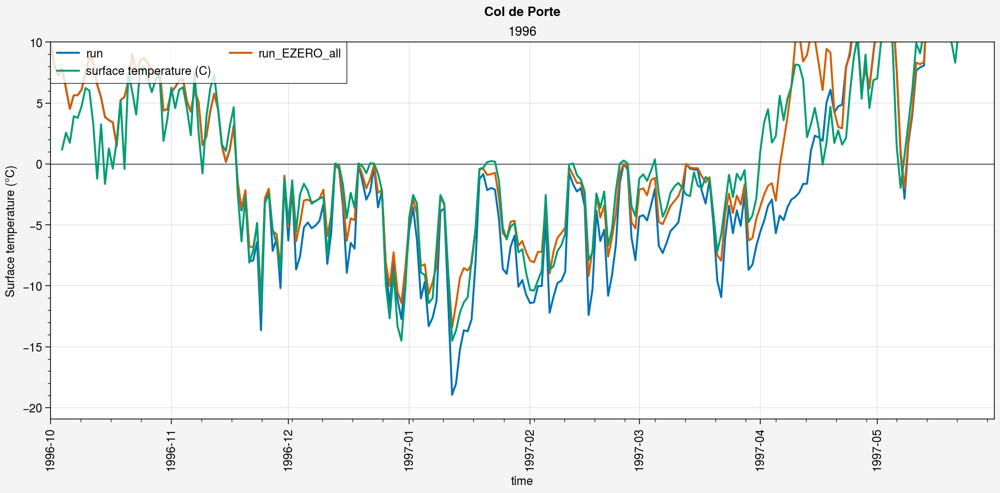

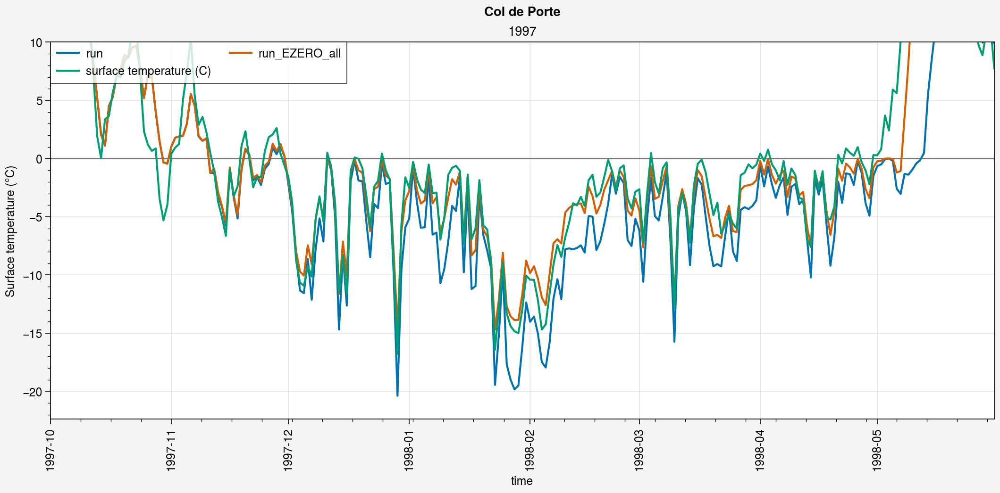

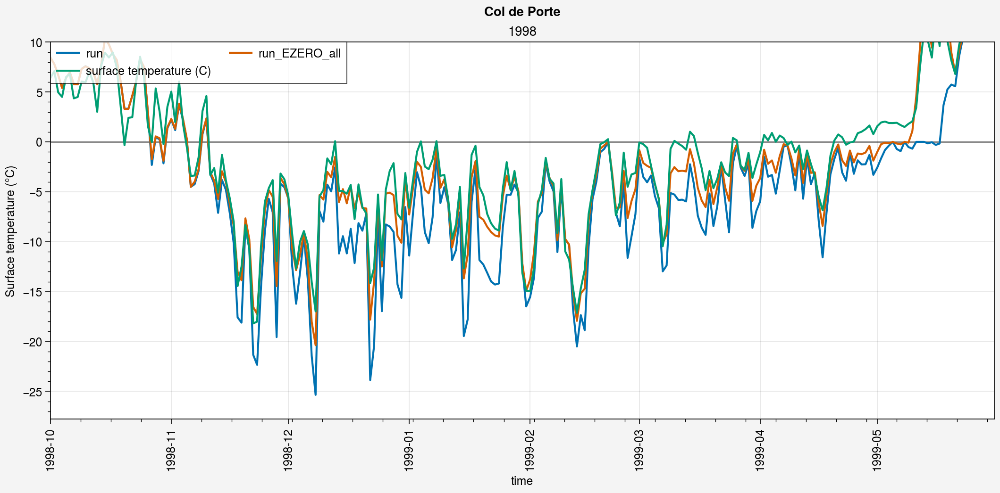

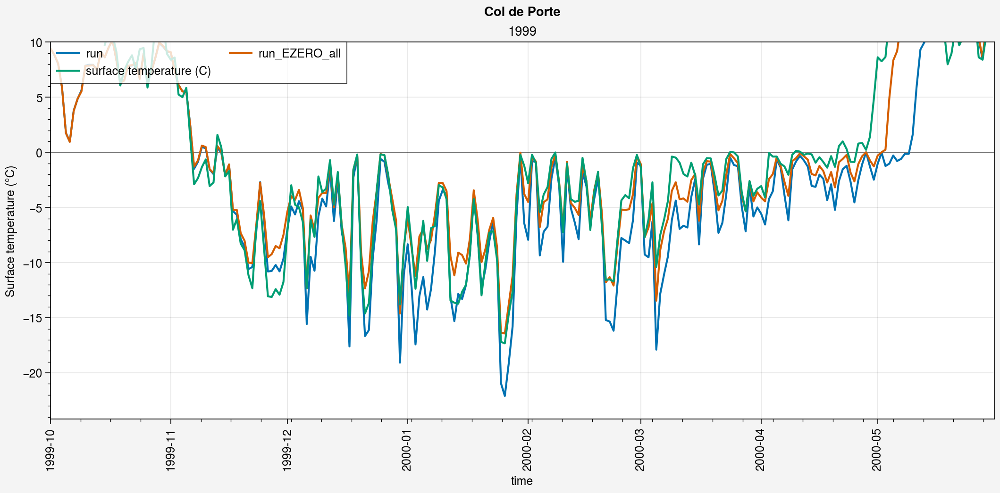

...

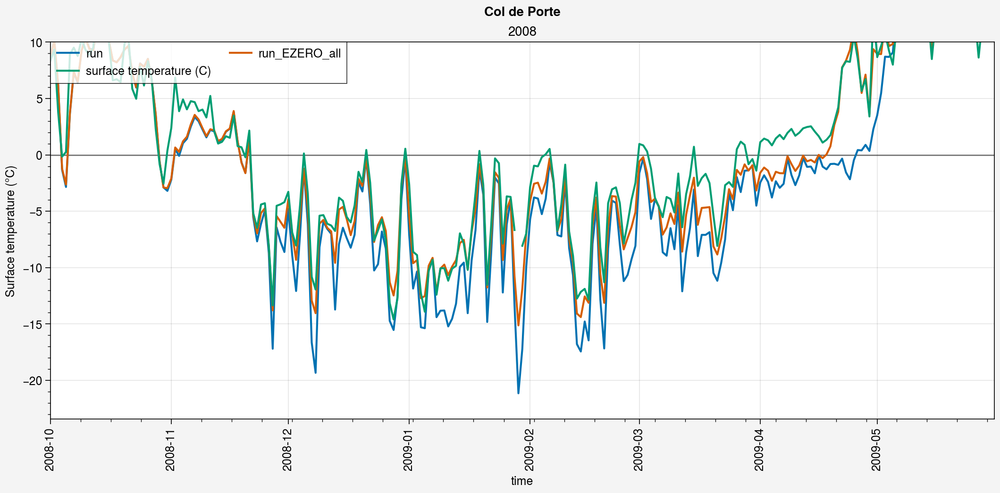

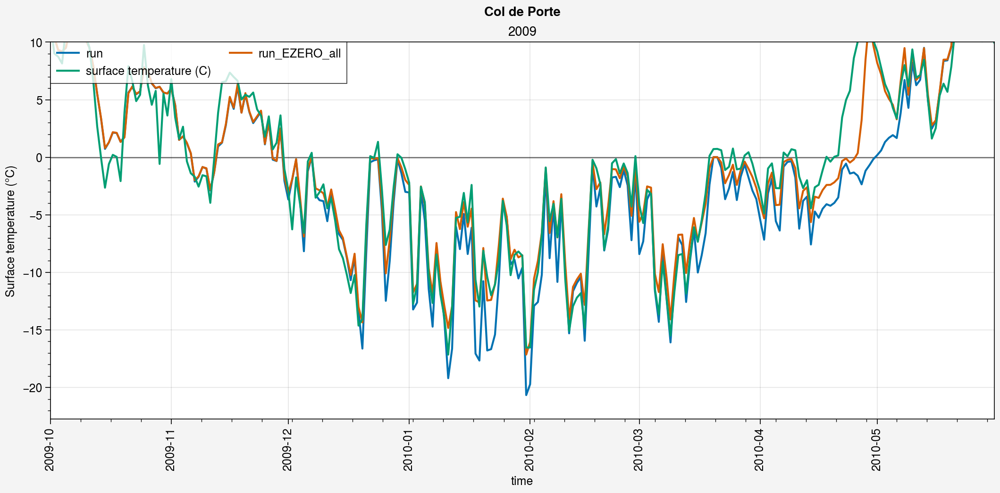

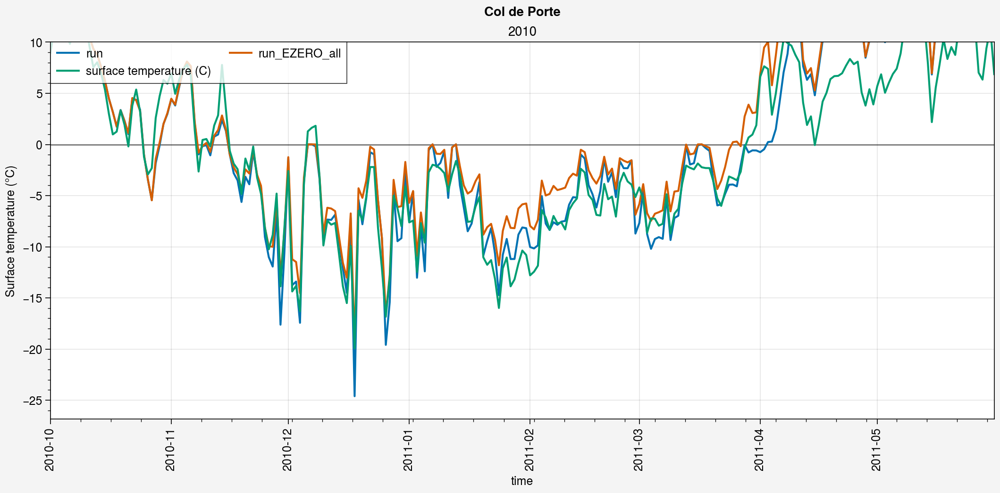

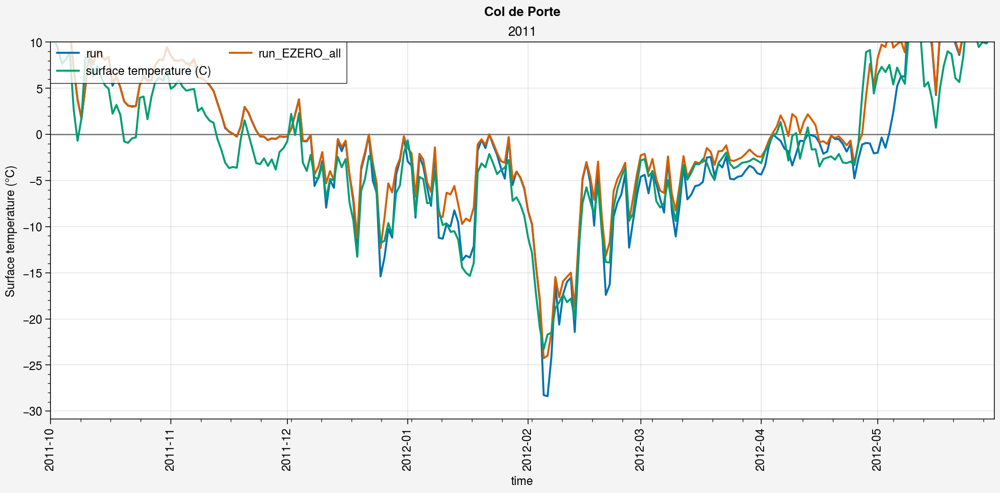

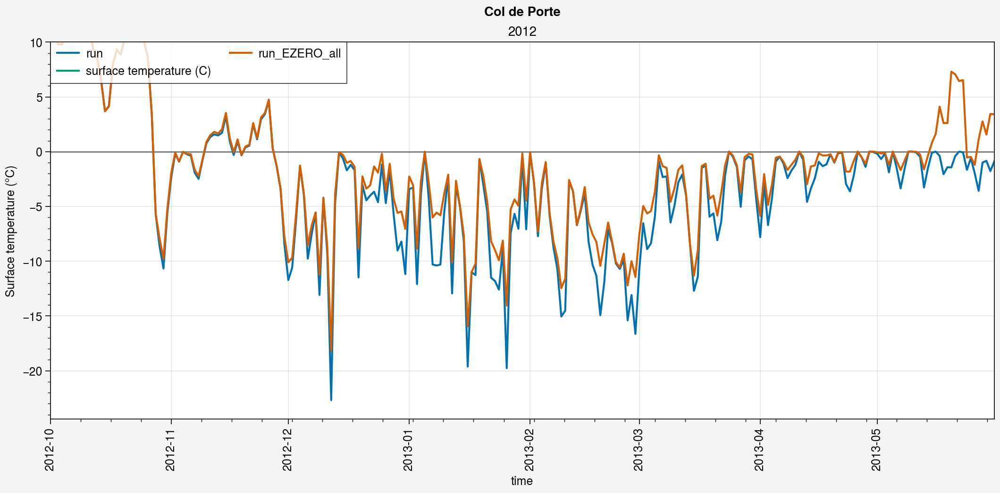

In [21]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.ts.sel(time=period).squeeze()-273.15, label=label)
    axs[0].plot(ds2_d.ts.sel(time=period).squeeze()-273.15, label=label2)
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.ts.sel(time=period))

    axs[0].hlines(0, ds_d.ts.sel(time=period).time[0], ds_d.ts.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Surface temperature (°C)', ymax=10)
    
    fig.suptitle('Col de Porte')


### Soil Temperature 10 cm

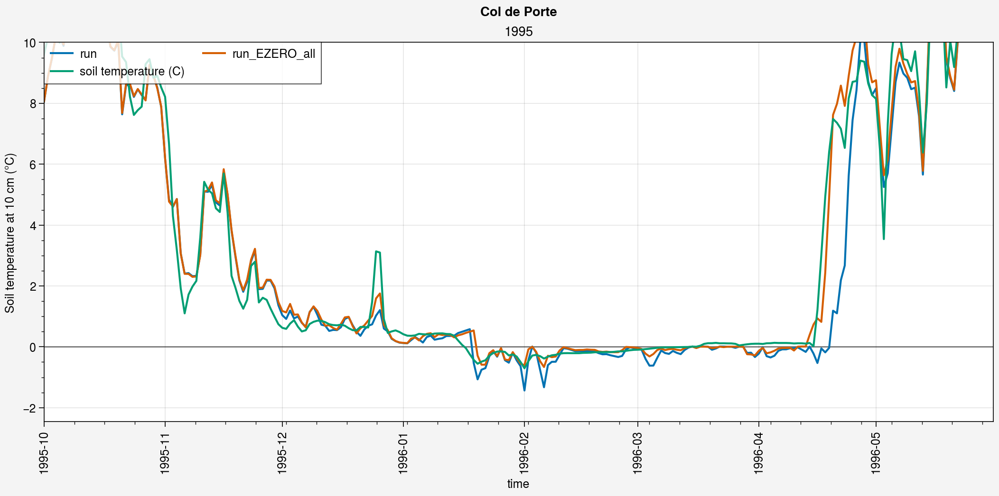

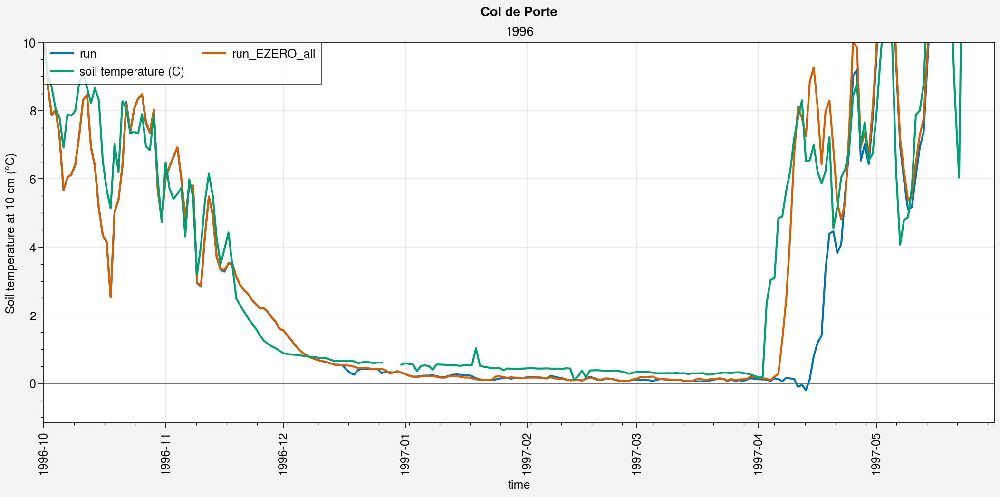

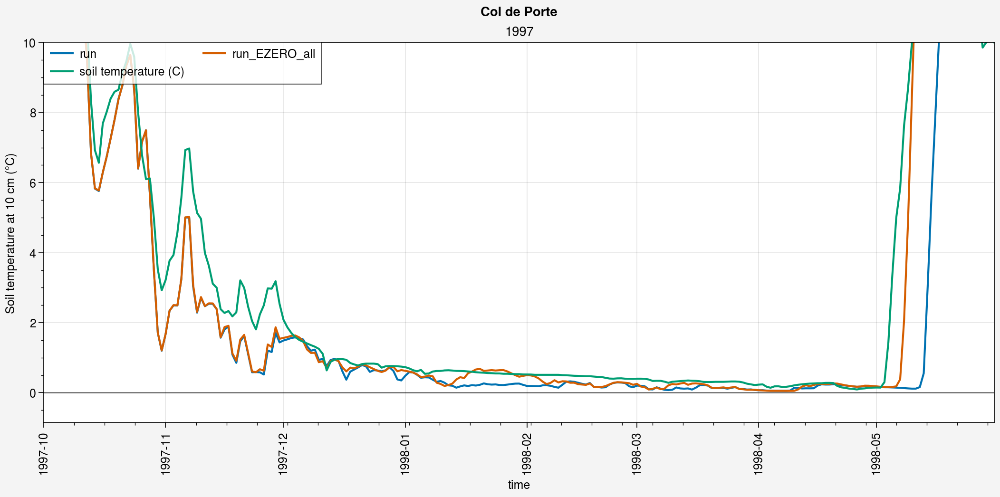

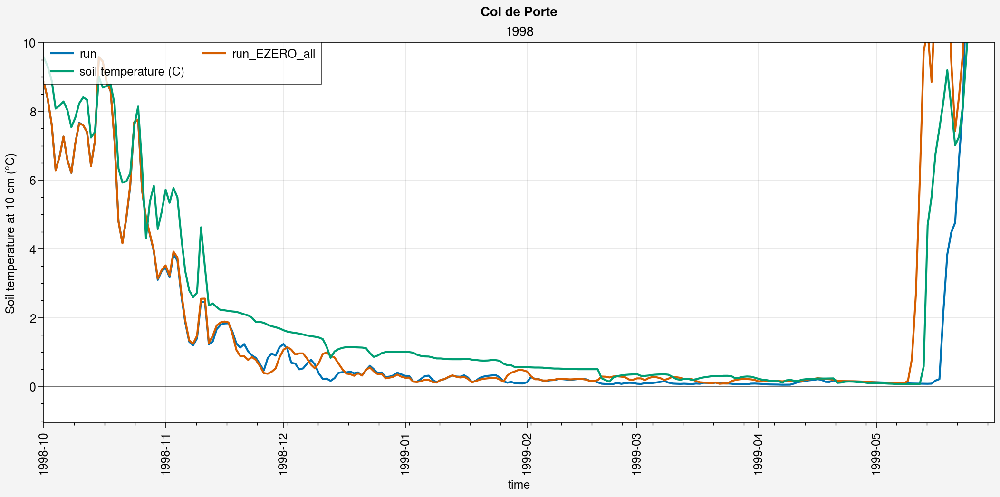

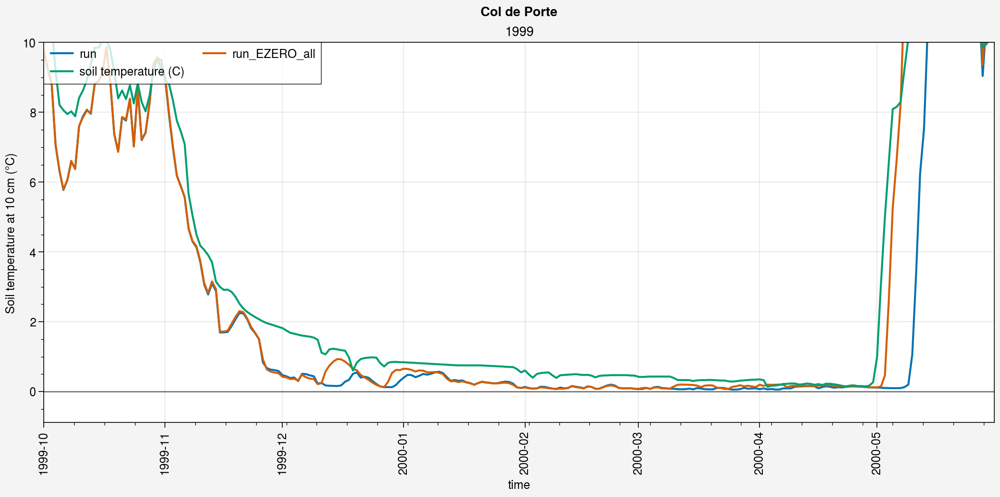

...

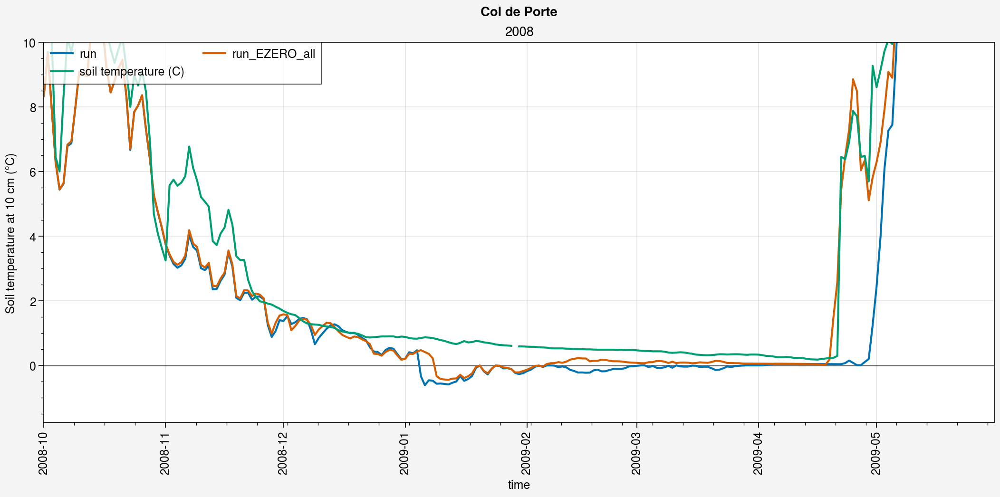

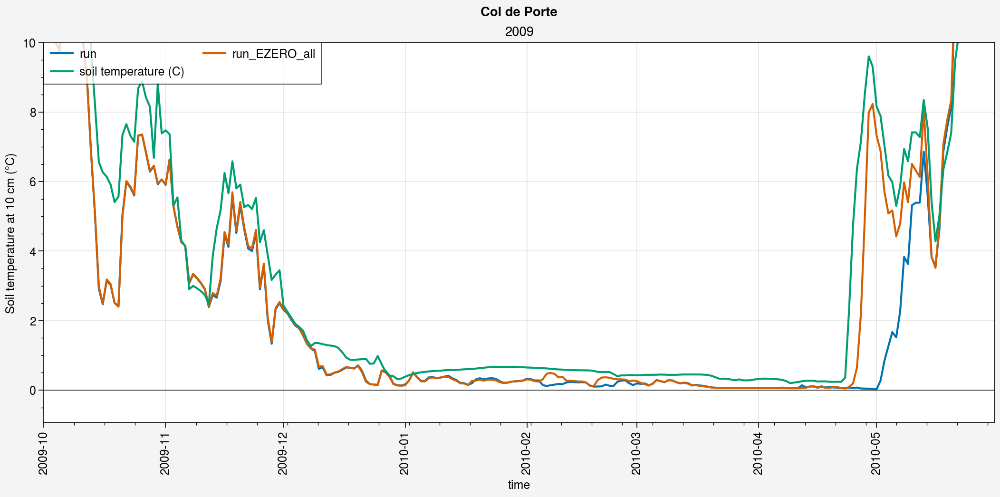

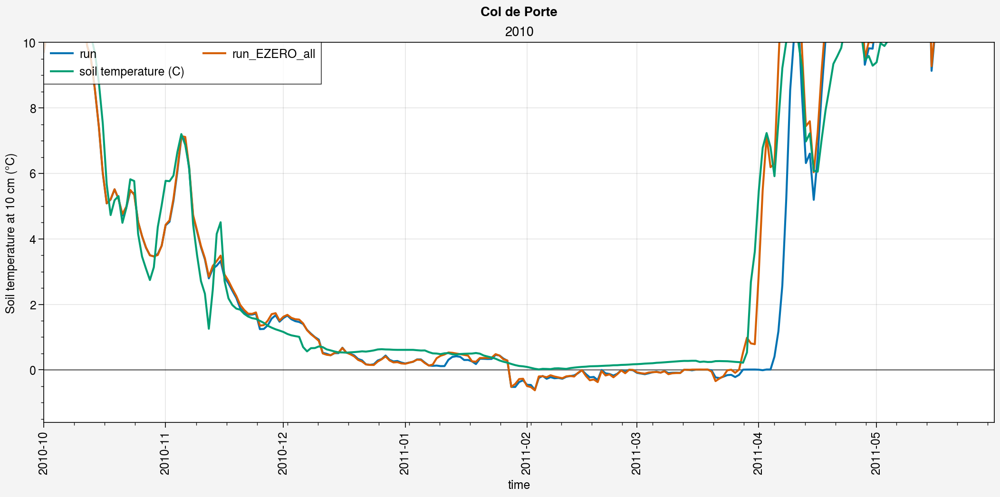

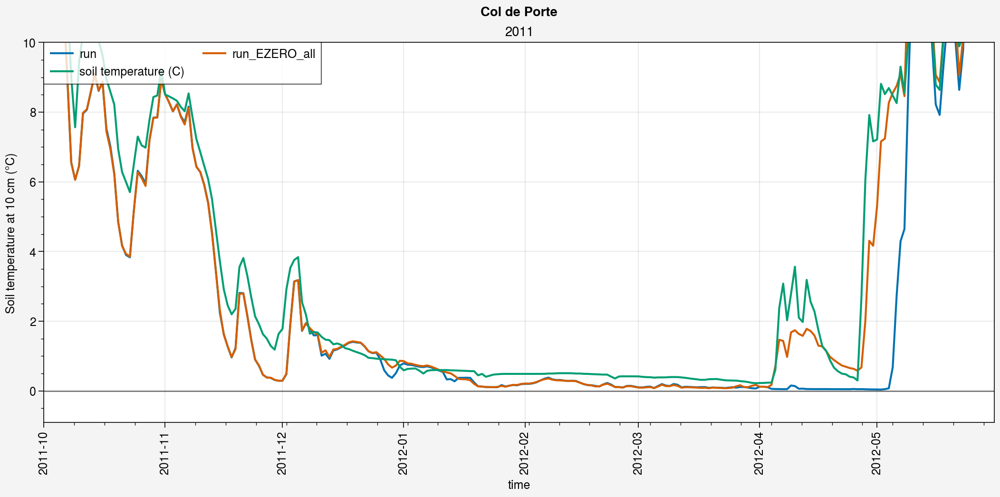

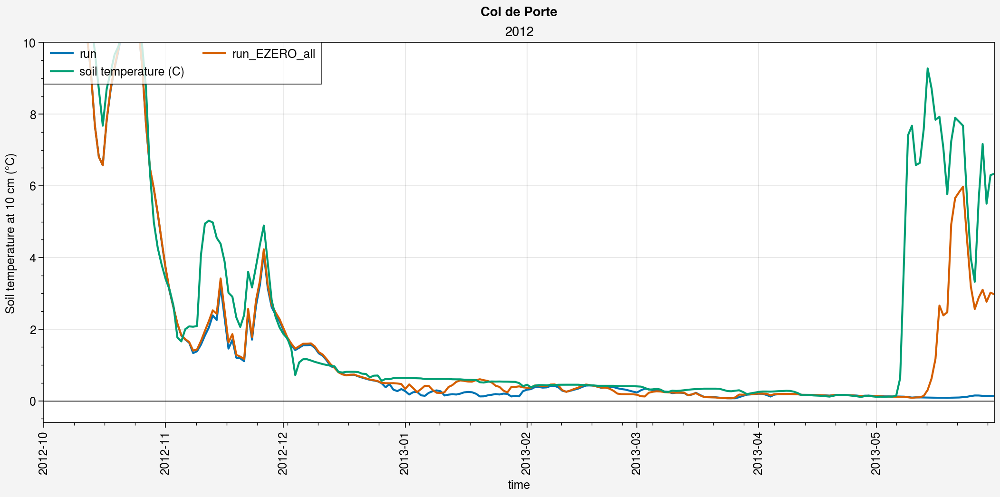

In [22]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(((ds_d.tsl.sel(time=period, layer=1)+ds_d.tsl.sel(time=period, layer=2))/2).squeeze()-273.15, label=label)
    axs[0].plot(((ds2_d.tsl.sel(time=period, layer=1)+ds2_d.tsl.sel(time=period, layer=2))/2).squeeze()-273.15, label=label2)
    
    # Obs
    axs[0].plot(ds_d_eval_menard2019.tsl.sel(time=period, sdepth=0.1))

    axs[0].hlines(0, ds_d.ts.sel(time=period).time[0], ds_d.ts.sel(time=period).time[-1], c='k', lw=1, alpha=0.5)
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Soil temperature at 10 cm (°C)', ymax=10)
    
    fig.suptitle('Col de Porte')


### Runoff

- `ds_h_eval_lejeune2019['Runoff_1m2']`
- `ds_h_eval_lejeune2019['Runoff_5m2']`

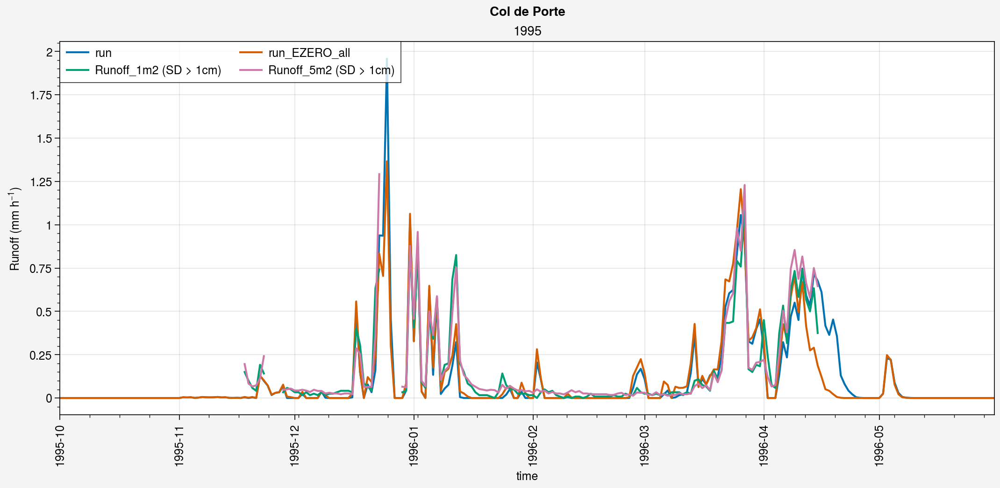

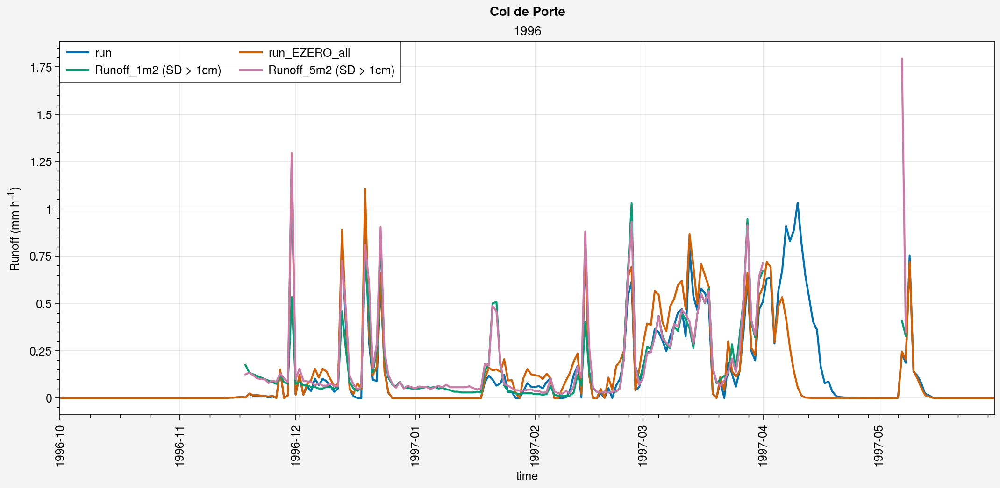

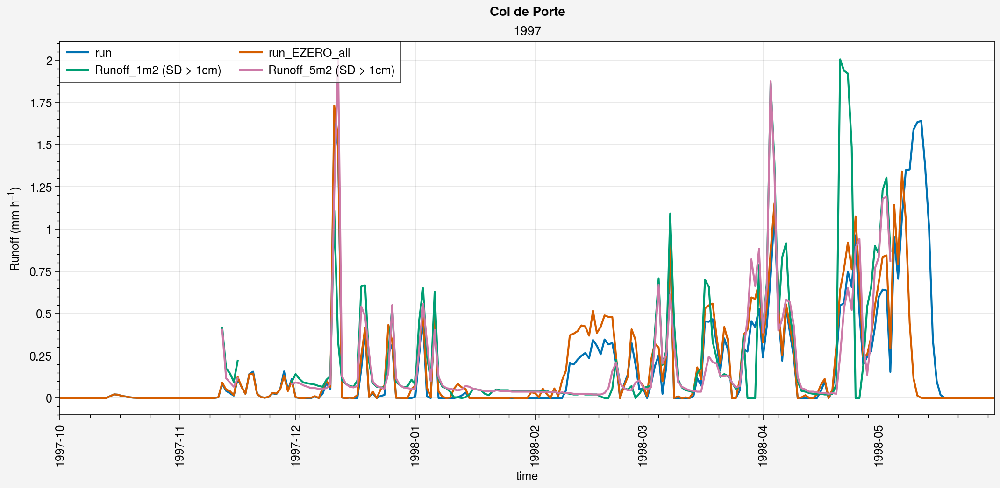

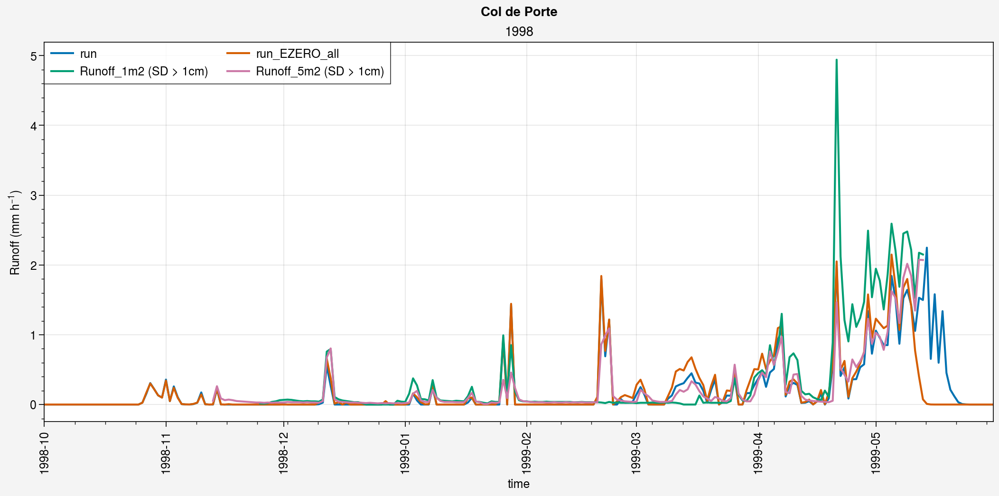

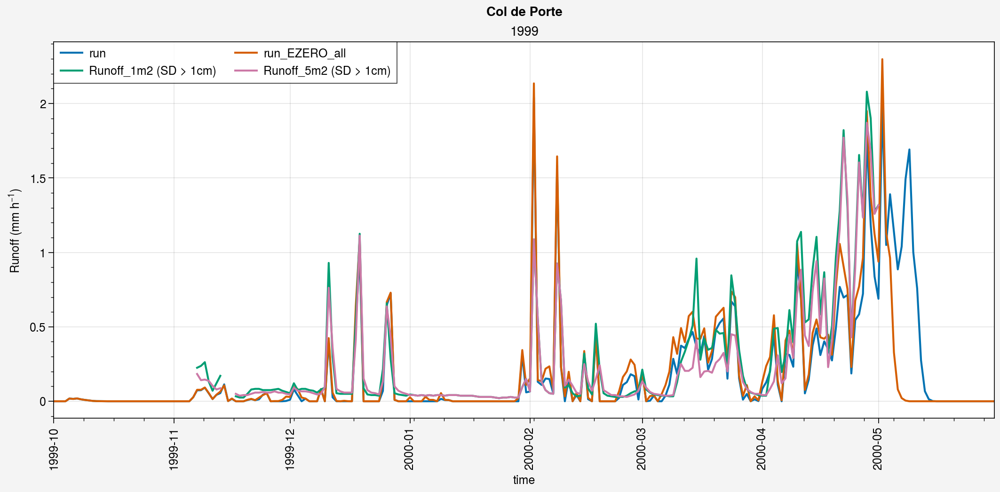

...

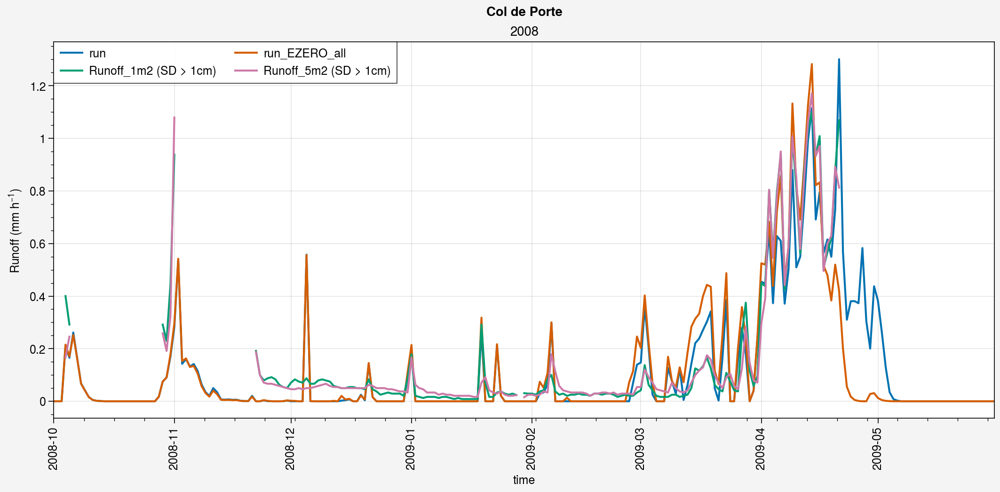

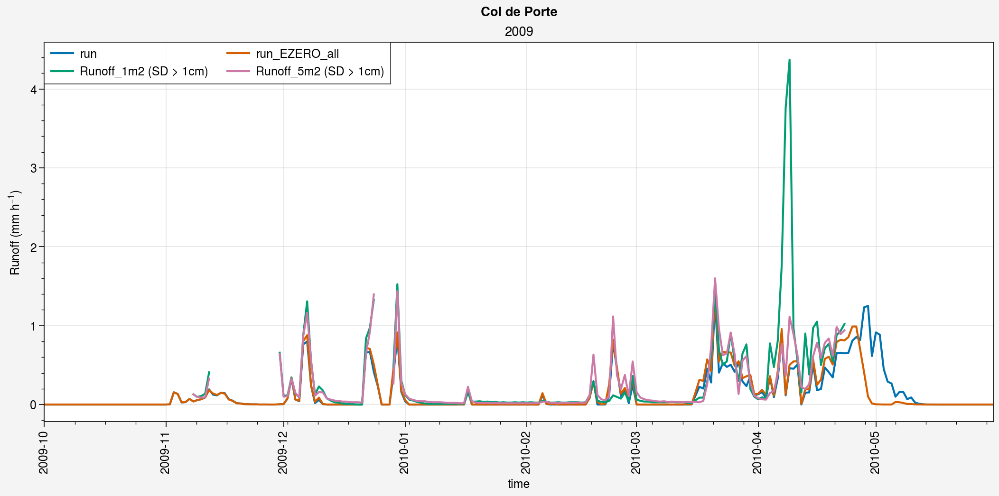

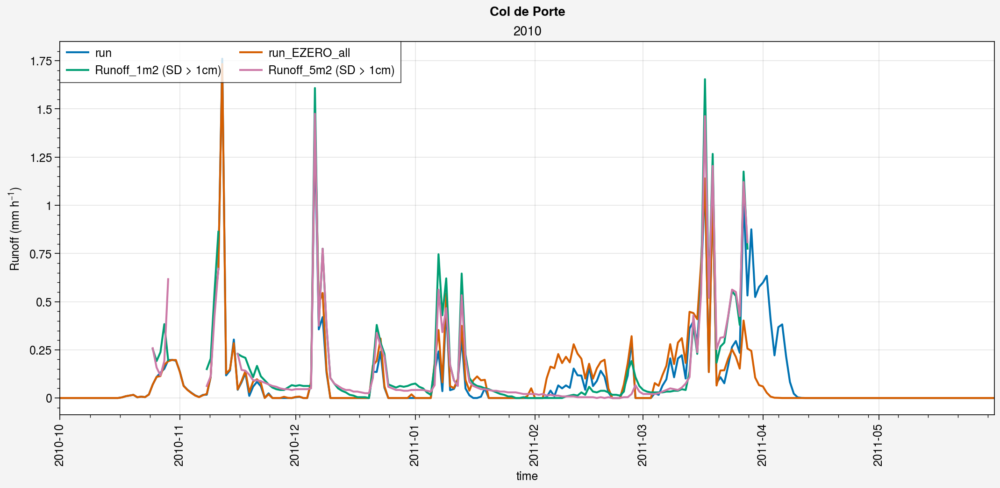

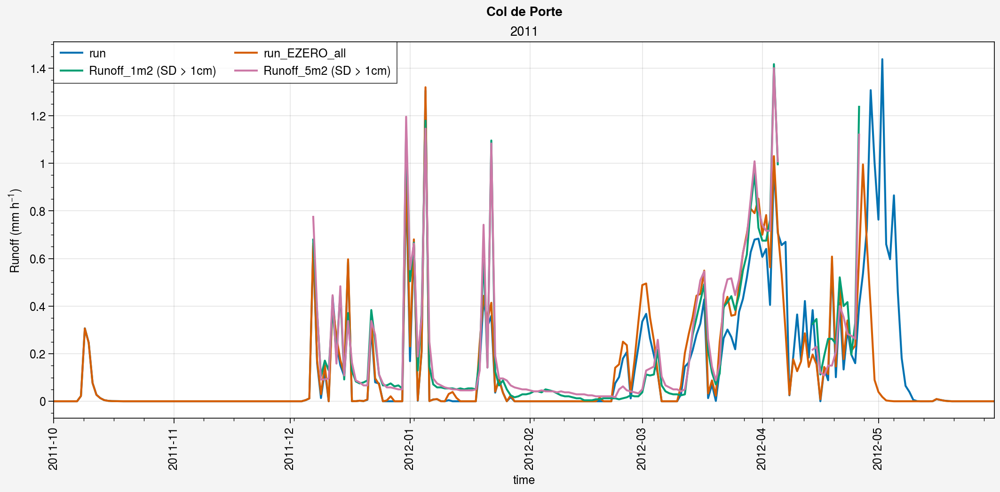

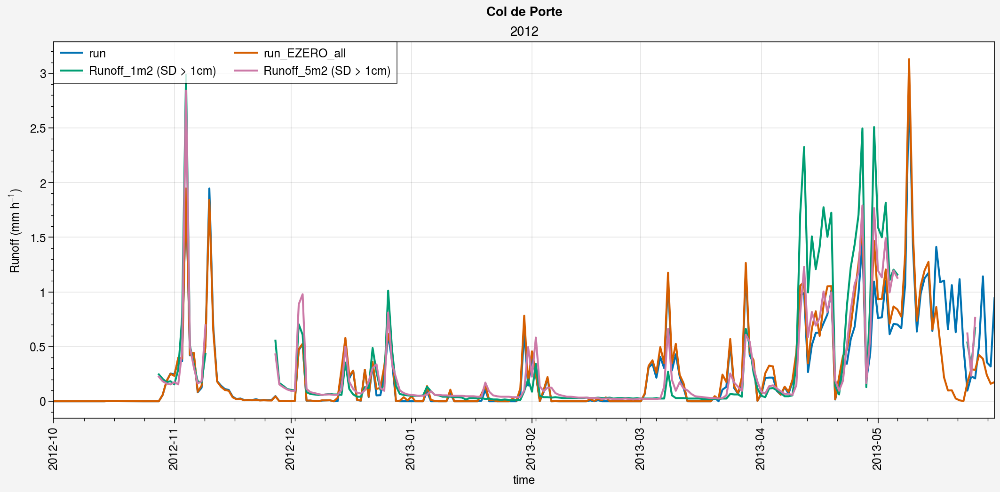

In [26]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_d.mrron.sel(time=period).squeeze()*60*60, label=label)
    axs[0].plot(ds2_d.mrron.sel(time=period).squeeze()*60*60, label=label2)

    # Obs
    axs[0].plot(ds_d_eval_lejeune2019['Runoff_1m2'].sel(time=period).where(
        ds_d_eval_menard2019.snd_auto.sel(time=period) > 0.01), label='Runoff_1m2 (SD > 1cm)')
    axs[0].plot(ds_d_eval_lejeune2019['Runoff_5m2'].sel(time=period).where(
        ds_d_eval_menard2019.snd_auto.sel(time=period) > 0.01), label='Runoff_5m2 (SD > 1cm)')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Runoff (mm h$^{-1}$)')
    
    fig.suptitle('Col de Porte')


### Snow profiles

Not easy to say if our forcing data are in local time and need to convert here or not...

In [130]:
from snowpyt import pit_class as pc

Theoric snow temperature within CLASSIC: https://cccma.gitlab.io/classic/snowHeatCond_8f90.html#details

In [141]:
import os

def sorted_directory_listing_with_os_listdir(directory):
    items = os.listdir(directory)
    sorted_items = sorted(items)
    return sorted_items

In [143]:
mypath = path_lejeune2019+'/CRYOBSCLIM.CDP.2018.SnowProfile/SnowProfile/'
files = sorted_directory_listing_with_os_listdir(mypath)

In [511]:
tsn_obs = []
date_obs = []
for file in files:
    p = pc.Snowpit()
    p.caaml_file = path_lejeune2019+'/CRYOBSCLIM.CDP.2018.SnowProfile/SnowProfile/'+file
    p.import_caamlv6(print2term=False)
    try:
        tsn_obs.append(np.trapz(p.temperature_profile.temp, x=-p.temperature_profile.depth)/p.temperature_profile.depth[0])
    except AttributeError:
        tsn_obs.append(np.nan)
    date_obs.append(p.metadata.date)
    # p.plot(plot_order=['density', 'temperature', 'stratigraphy', 'hardness'])

In [359]:
d = {'tsn': tsn_obs}
df_tsn = pd.DataFrame(data=d, index=pd.to_datetime(date_obs).tz_convert('Europe/Paris').tz_localize(None))
df_tsn = df_tsn.dropna()
ds_tsn_loc = df_tsn.to_xarray()
ds_tsn_loc = ds_tsn_loc.rename({'index': 'time'})
ds_tsn_loc = ds_tsn_loc.reindex({'time': pd.date_range(ds_tsn_loc.tsn.time[0].values, ds_tsn_loc.tsn.time[-1].values, freq='H')})

In [360]:
d = {'tsn': tsn_obs}
df_tsn = pd.DataFrame(data=d, index=pd.to_datetime(date_obs).tz_localize(None))
df_tsn = df_tsn.dropna()
ds_tsn = df_tsn.to_xarray()
ds_tsn = ds_tsn.rename({'index': 'time'})
ds_tsn = ds_tsn.reindex({'time': pd.date_range(ds_tsn.tsn.time[0].values, ds_tsn.tsn.time[-1].values, freq='H')})

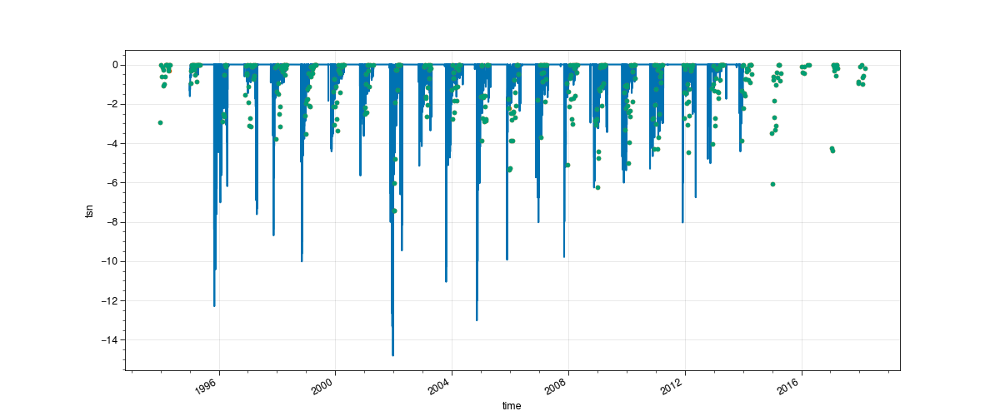

In [361]:
%matplotlib widget
plt.figure(figsize=(12,5))
ds_hh.tsn.plot()
ds_tsn_loc.tsn.plot(marker='.')
ds_tsn.tsn.plot(marker='.')

#### Disk

In [559]:
# temp_list = []
# height_list = []
# for j in range(ds_h_eval_lejeune2019.time.size):
#     temp = []
#     height = []
#     for i in pplt.arange(1, 20):
#         height.append(ds_h_eval_lejeune2019['Settling_disks_height_'+str(i)][j].values.item(0))
#         temp.append(ds_h_eval_lejeune2019['Settling_disks_temp_'+str(i)][j].values.item(0)-273.15)
#     height_list.append(height)
#     temp_list.append(temp)

In [560]:
# ds = xr.Dataset(
#     data_vars=dict(
#         temperature=(["time", "disk"], temp_list),
#         height=(["time", "disk"], height_list),
#     ),
#     coords=dict(
#         disk=pplt.arange(1, 20),
#         time=ds_h_eval_lejeune2019.time,
#     ),
# )

In [564]:
# ds.to_netcdf('cdp_disk.nc')
ds = xr.open_dataset('cdp_disk.nc')
ds

In [578]:
tsn_obs_profile_list = []
date_obs_profile_list = []
depth_obs_profile_list = []
for file in files:
    p = pc.Snowpit()
    p.caaml_file = path_lejeune2019+'/CRYOBSCLIM.CDP.2018.SnowProfile/SnowProfile/'+file
    p.import_caamlv6(print2term=False)
    try:
        tsn_obs_profile_list.append(list(p.temperature_profile.temp))
        depth_obs_profile_list.append(list(p.temperature_profile.depth))
        date_obs_profile_list.append(p.metadata.date)
    except AttributeError:
        pass

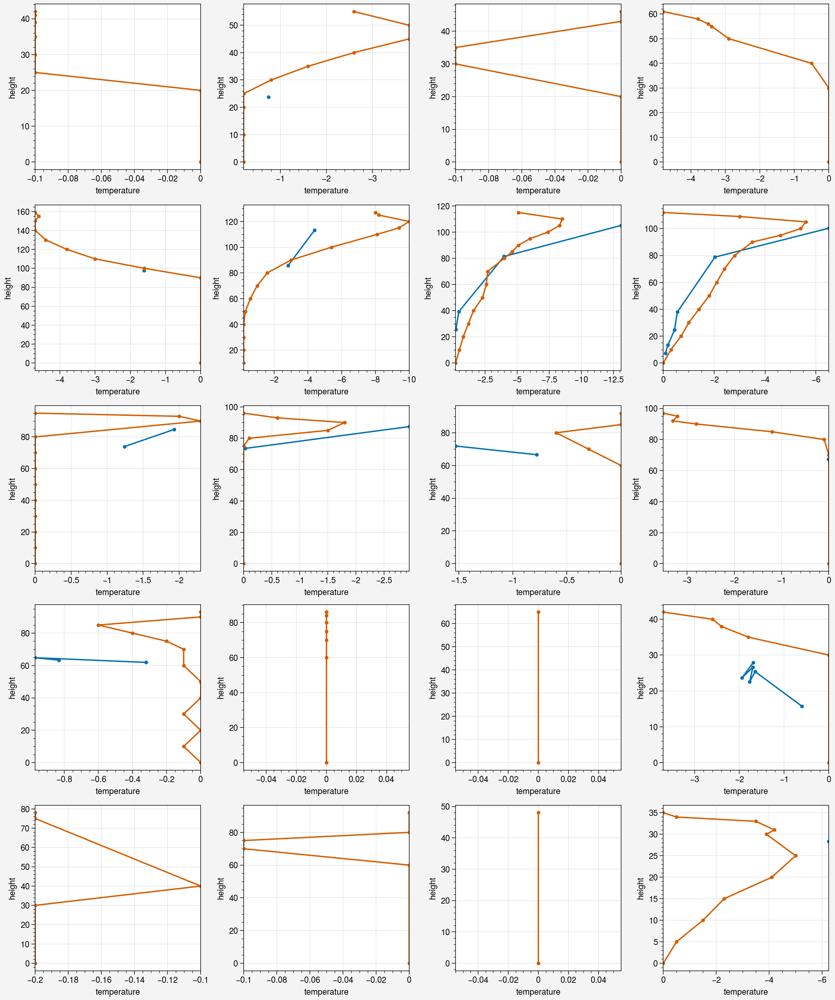

In [611]:
fig, axs = pplt.subplots(ncols=4, nrows=5, share=0)

# for i in range(len(date_obs_profile_list)):
for i, k in enumerate(pplt.arange(60,79)):
    date = date_obs_profile_list[k][:-6]
    axs[i].plot(ds.sel(time=date).temperature, ds.sel(time=date).height*1e2, marker='.')
    axs[i].plot(tsn_obs_profile_list[k], depth_obs_profile_list[k], marker='.')

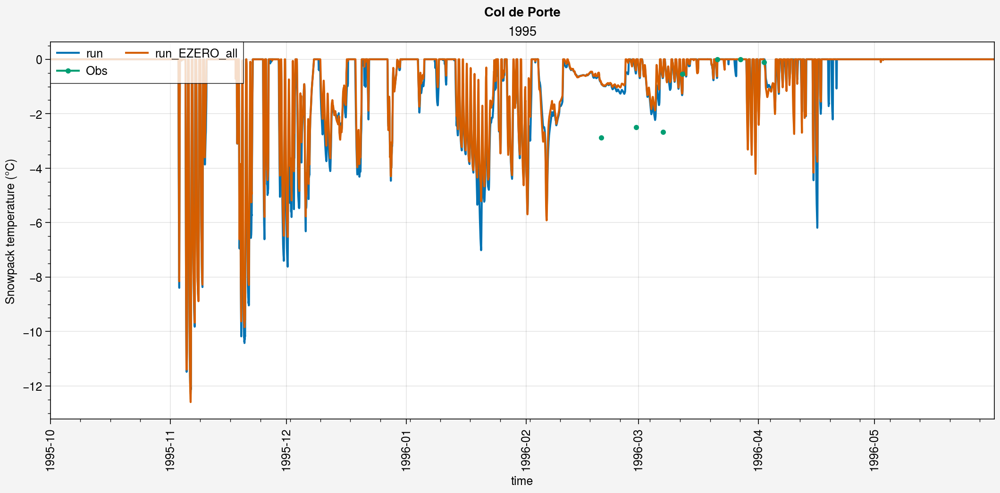

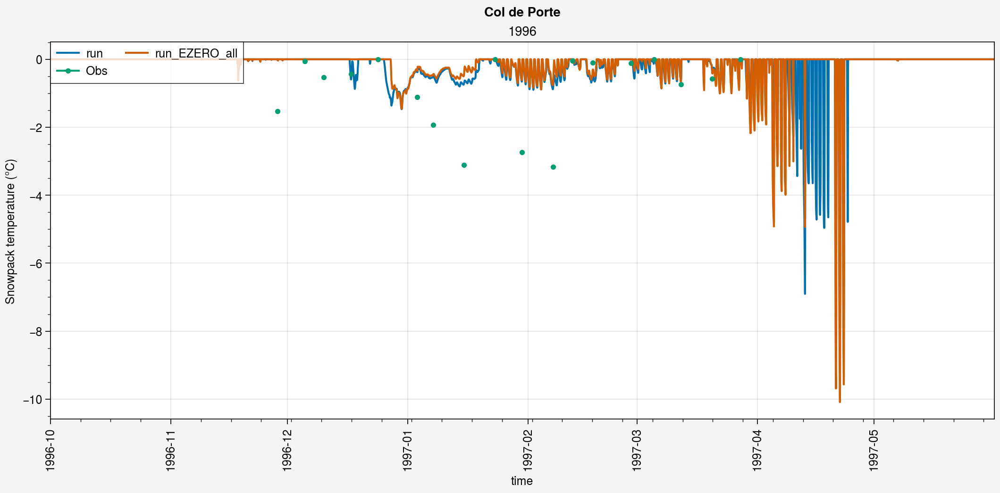

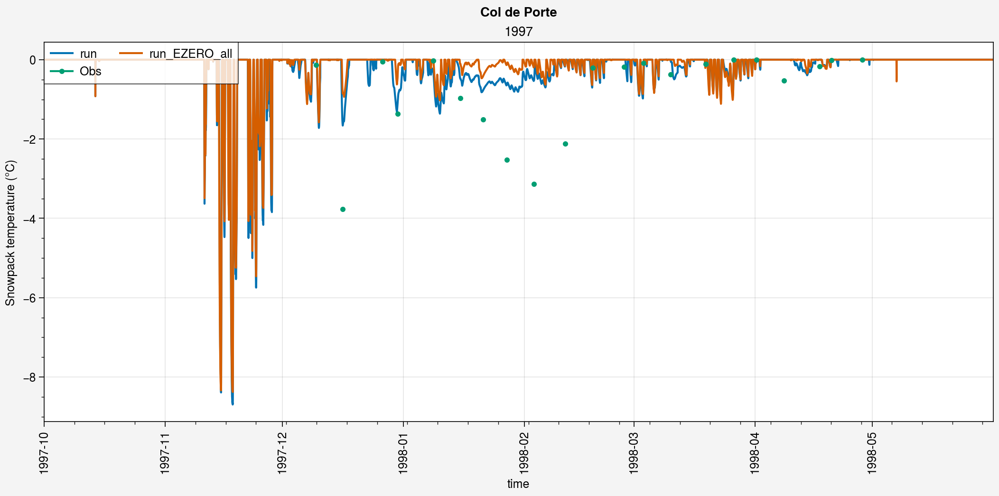

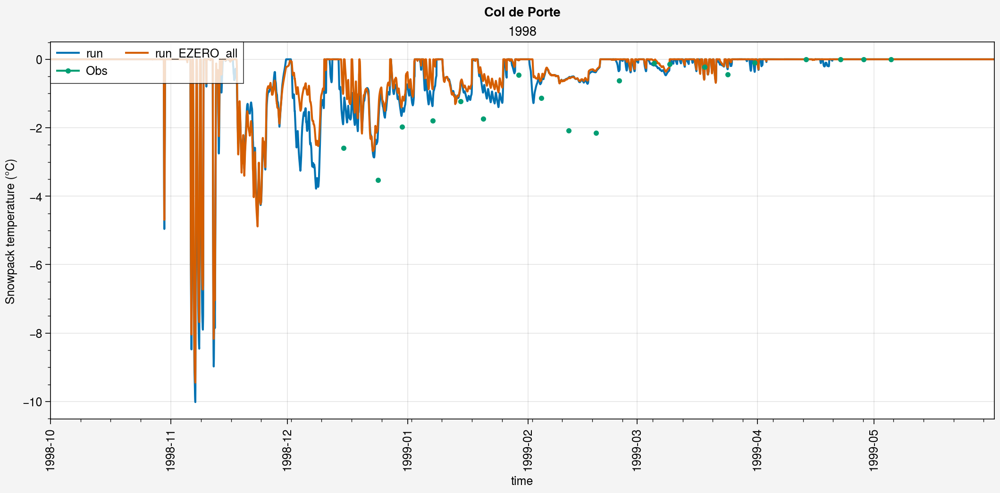

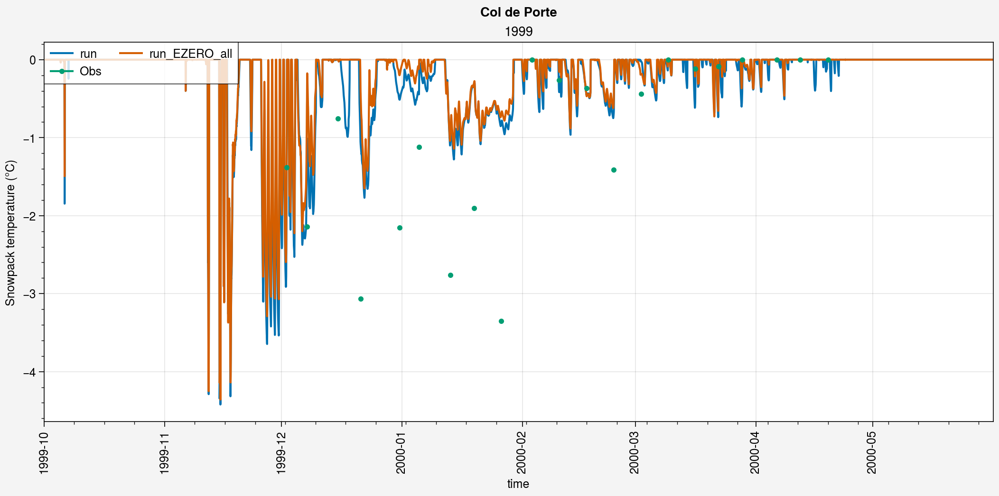

...

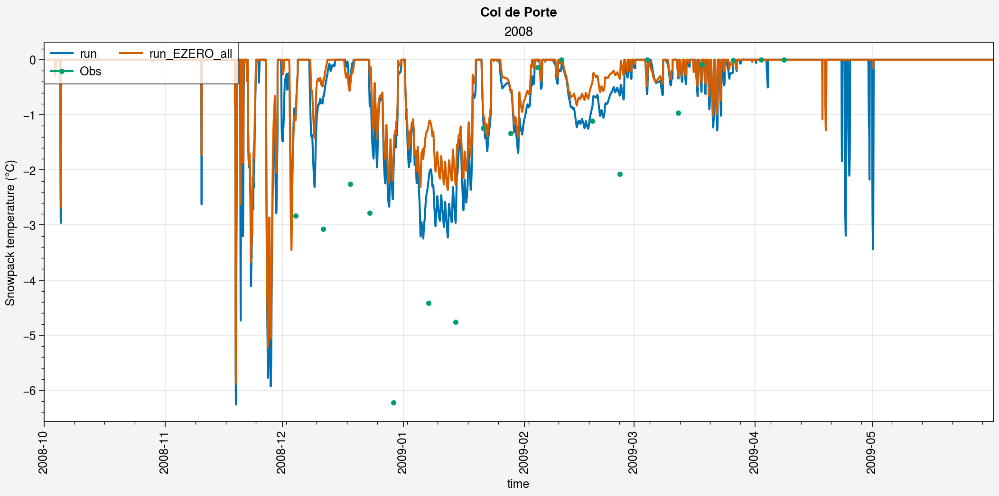

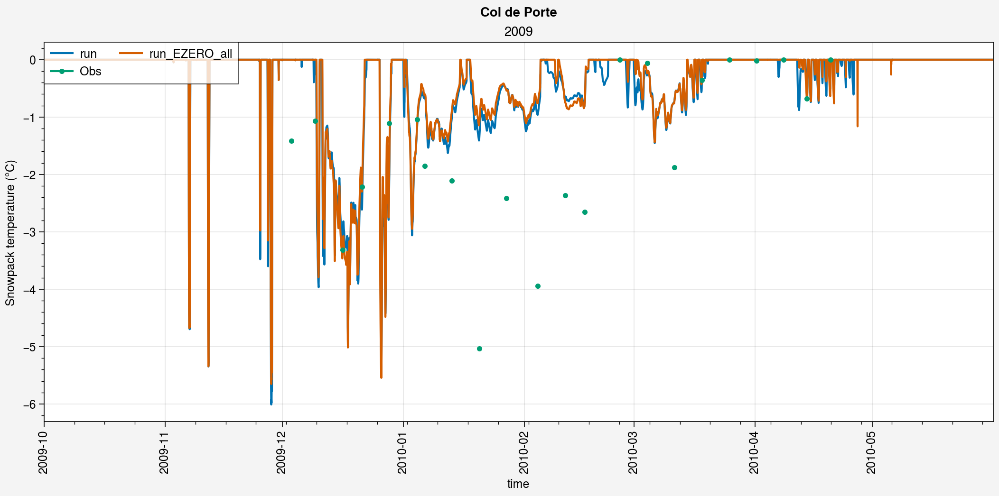

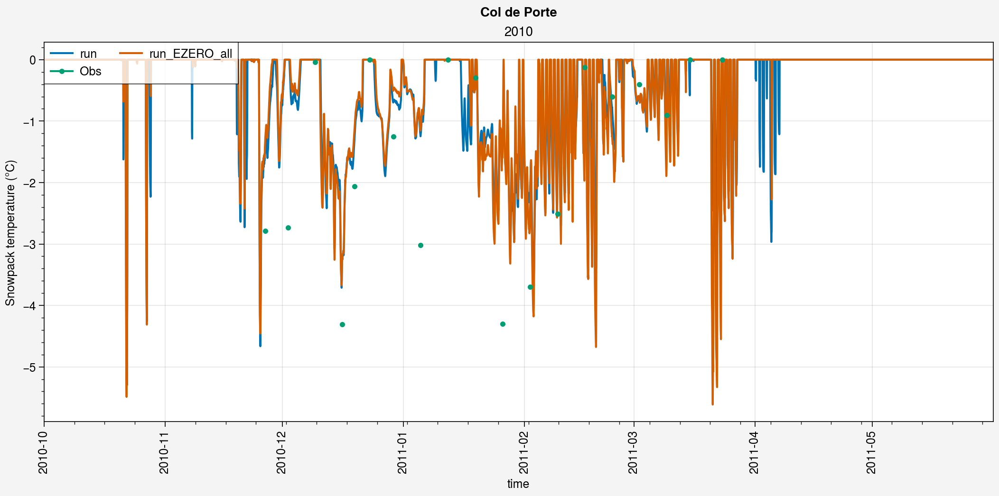

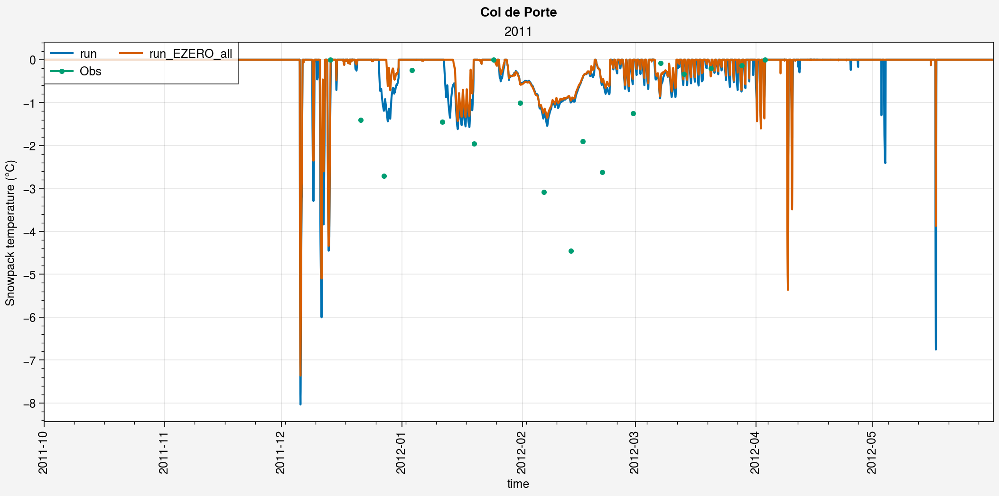

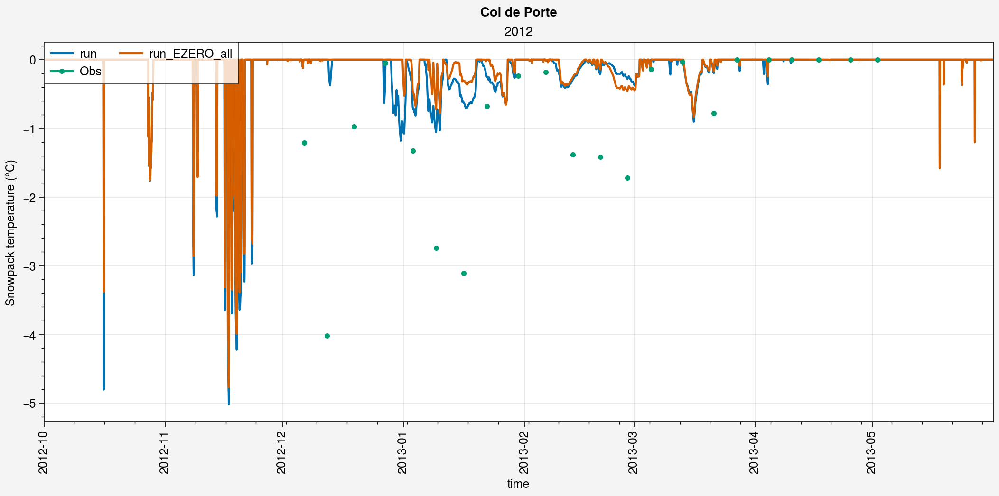

In [494]:
%matplotlib inline
# for year in pplt.arange(1995, 1995):
for year in pplt.arange(1995, 2012):
    fig, axs = pplt.subplots(ncols=1, nrows=1, refaspect=2.5, refwidth=10)
    
    period=slice(str(year)+'-10',str(year+1)+'-05')
    
    # Simus
    axs[0].plot(ds_hh.tsn.sel(time=period).squeeze(), label=label)
    axs[0].plot(ds2_hh.tsn.sel(time=period).squeeze(), label=label2)

    # Obs
    axs[0].plot(ds_tsn.tsn.sel(time=period), label='Obs', marker='.')
    
    axs[0].legend(loc='ul', ncols=2)
    axs[0].format(title=str(year), ylabel='Snowpack temperature (°C)')
    
    fig.suptitle('Col de Porte')


## Annual cycles comparison

Text(0.5, 0.98, 'Col de Porte (1995-2012)')

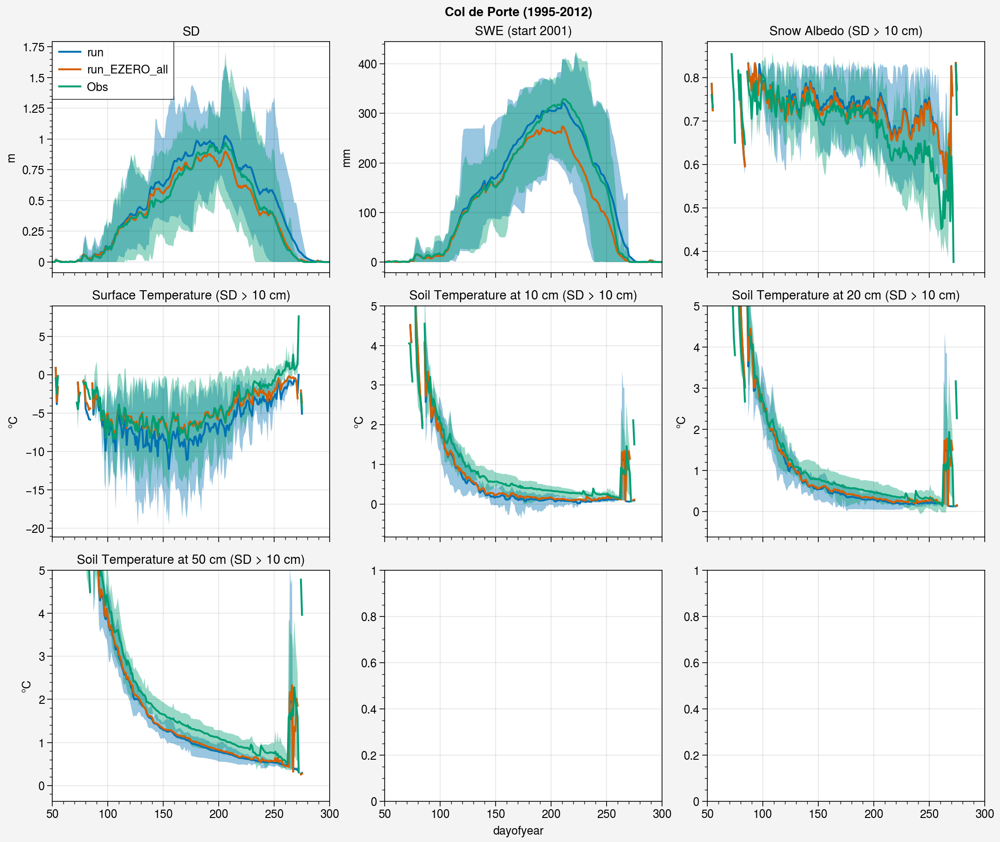

In [117]:
import warnings
warnings.filterwarnings("ignore")

fig, axs = pplt.subplots(ncols=3, nrows=3, refwidth=3, refaspect=1.2, sharey=0)

doy = 140
period = slice('1995', '2012')

ax = axs[0]
mask_obs = ~ds_d_eval_menard2019.snd_auto.sel(time=period).isnull()
shadedata = ds_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
h1 = ax.plot(ds_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata, label=label)
h2 = ax.plot(ds2_d.snd.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), label=label2)

shadedata = ds_d_eval_menard2019.snd_auto.sel(time=period).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
h3 = ax.plot(ds_d_eval_menard2019.snd_auto.sel(time=period).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata, label='Obs')
ax.format(title='SD', ylabel='m')
ax.legend([h1, h2, h3], loc='ul', ncols=1)


ax = axs[1]
mask_obs = ~ds_d_eval_menard2019.snw_auto.sel(time=period).isnull()
shadedata = ds_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.plot(ds2_d.snw.sel(time=period).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze())

shadedata = ds_d_eval_menard2019.snw_auto.sel(time=period).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.snw_auto.sel(time=period).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='SWE (start 2001)', ylabel='mm')


ax = axs[2]
mask_obs = ~ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ds_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.plot(ds2_d.albsn.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze())

shadedata = ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Snow Albedo (SD > 10 cm)', ylabel='')


ax = axs[3]
mask_obs = ~ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ds_d.ts.where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')-273.15
ax.plot(ds_d.ts.where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15, shadedata=shadedata)
ax.plot(ds2_d.ts.where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15)

shadedata = ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Surface Temperature (SD > 10 cm)', ylabel='°C')


ax = axs[4]
mask_obs = ~ds_d_eval_menard2019.tsl.sel(sdepth=0.1).where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ((ds_d.tsl.sel(layer=1)+ds_d.tsl.sel(layer=2))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')-273.15
ax.plot(((ds_d.tsl.sel(layer=1)+ds_d.tsl.sel(layer=2))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15, shadedata=shadedata)
ax.plot(((ds2_d.tsl.sel(layer=1)+ds2_d.tsl.sel(layer=2))/2).where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15)

shadedata = ds_d_eval_menard2019.tsl.sel(sdepth=0.1).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.1).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Soil Temperature at 10 cm (SD > 10 cm)', ylabel='°C', ymax=5)


ax = axs[5]
mask_obs = ~ds_d_eval_menard2019.tsl.sel(sdepth=0.2).where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ((ds_d.tsl.sel(layer=2)+ds_d.tsl.sel(layer=3))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')-273.15
ax.plot(((ds_d.tsl.sel(layer=2)+ds_d.tsl.sel(layer=3))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15, shadedata=shadedata)
ax.plot(((ds2_d.tsl.sel(layer=2)+ds2_d.tsl.sel(layer=3))/2).where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15)

shadedata = ds_d_eval_menard2019.tsl.sel(sdepth=0.2).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.2).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Soil Temperature at 20 cm (SD > 10 cm)', ylabel='°C', ymax=5)


ax = axs[6]
mask_obs = ~ds_d_eval_menard2019.tsl.sel(sdepth=0.5).where(ds_d_eval_menard2019.snd_auto > 0.1).isnull()
shadedata = ((ds_d.tsl.sel(layer=5)+ds_d.tsl.sel(layer=6))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')-273.15
ax.plot(((ds_d.tsl.sel(layer=5)+ds_d.tsl.sel(layer=6))/2).where(ds_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15, shadedata=shadedata)
ax.plot(((ds2_d.tsl.sel(layer=5)+ds2_d.tsl.sel(layer=6))/2).where(ds2_d.snd > 0.1).where(mask_obs).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze()-273.15)

shadedata = ds_d_eval_menard2019.tsl.sel(sdepth=0.5).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').quantile([0.1, 0.9]).sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze().transpose('quantile', 'dayofyear')
ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.5).where(ds_d_eval_menard2019.snd_auto > 0.1).groupby('time.dayofyear').mean().sel(dayofyear=slice(1,365)).roll(dayofyear=doy).squeeze(), shadedata=shadedata)
ax.format(title='Soil Temperature at 50 cm (SD > 10 cm)', ylabel='°C', ymax=5)


for ax in axs:
    ax.format(xlim=(50,300))

fig.suptitle('Col de Porte ('+period.start+'-'+period.stop+')')




## Time series

In [495]:
def mb(simu, obs):
    return (simu-obs).mean().values.item(0)

def rmb(simu, obs):
    return ((simu-obs).mean()/np.abs(obs.mean())).values.item(0)*100
    
def mab(simu, obs):
    return (np.abs(simu-obs)).mean().values.item(0)

def rmab(simu, obs):
    return ((np.abs(simu-obs)).mean()/np.abs(obs.mean())).values.item(0)*100
    
def rmse(simu, obs):
    return np.sqrt(((simu-obs)**2).mean()).values.item(0)

def rrmse(simu, obs):
    return (np.sqrt(((simu-obs)**2).mean())/np.abs(obs.mean())).values.item(0)*100
    
def corr(simu, obs):
    return xr.corr(simu, obs).values.item(0)

In [496]:
def mb_a(simu, obs):
    return (simu-obs).mean()

def rmb_a(simu, obs):
    return ((simu-obs).mean()/np.abs(obs.mean()))*100
    
def mab_a(simu, obs):
    return (np.abs(simu-obs)).mean()

def rmab_a(simu, obs):
    return ((np.abs(simu-obs)).mean()/np.abs(obs.mean()))*100
    
def rmse_a(simu, obs):
    return np.sqrt(((simu-obs)**2).mean())

def rrmse_a(simu, obs):
    return (np.sqrt(((simu-obs)**2).mean())/np.abs(obs.mean()))*100
    
def corr_a(simu, obs):
    r, _ = stats.pearsonr(simu, obs)
    return r

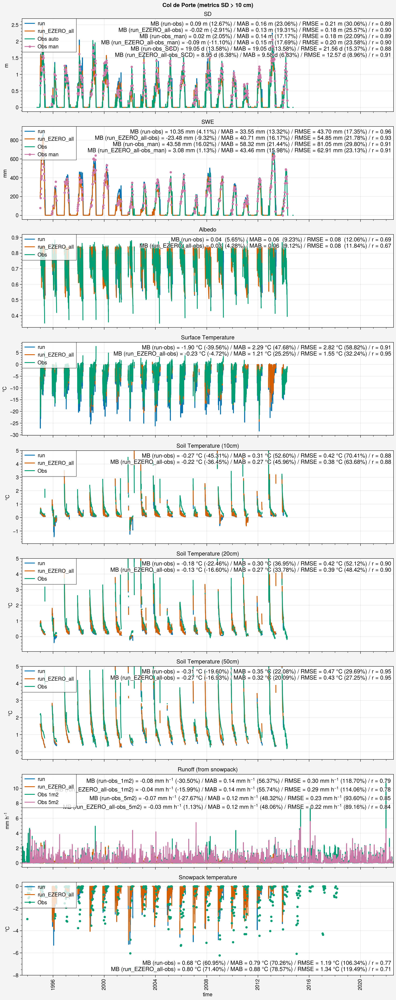

In [507]:
%matplotlib inline
fig, axs = pplt.subplots(ncols=1, nrows=9, refaspect=4, refwidth=9, sharey=0)

##########
### SD ###
##########

# Plot
ax = axs[0]
h1 = ax.plot(ds_d.snd.squeeze(), label=label)
h2 = ax.plot(ds2_d.snd.squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.snd_auto, label='Obs auto')
h4 = ax.plot(ds_d_eval_menard2019.snd_man, label='Obs man', marker='.')

# Metrics
obs = ds_d_eval_menard2019.snd_auto.where(ds_d_eval_menard2019.snd_auto > 0.1)
obs_man = ds_d_eval_menard2019.snd_man.where(ds_d_eval_menard2019.snd_man > 0.1)
simu1 = ds_d.snd.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.snd.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

mb1_man = mb(simu1, obs_man); mb2_man = mb(simu2, obs_man); rmb1_man = rmb(simu1, obs_man); rmb2_man = rmb(simu2, obs_man)
mab1_man = mab(simu1, obs_man); mab2_man = mab(simu2, obs_man); rmab1_man = rmab(simu1, obs_man); rmab2_man = rmab(simu2, obs_man)
rmse1_man = rmse(simu1, obs_man); rmse2_man = rmse(simu2, obs_man); rrmse1_man = rrmse(simu1, obs_man); rrmse2_man = rrmse(simu2, obs_man)
corr1_man = corr(simu1, obs_man); corr2_man = corr(simu2, obs_man)

SCD_obs = []; SCD_ds1 = []; SCD_ds2 = []
for year in pplt.arange(1995, 2013):
    SCD_obs.append(ds_d_eval_menard2019.snd_auto.sel(time=str(year)).where(ds_d_eval_menard2019.snd_auto.sel(time=str(year)) >  0.1).count().values.item(0))
    SCD_ds1.append(ds_d.snd.sel(time=str(year)).where(ds_d.snd.sel(time=str(year)) >  0.1).count().values.item(0))
    SCD_ds2.append(ds2_d.snd.sel(time=str(year)).where(ds2_d.snd.sel(time=str(year)) >  0.1).count().values.item(0))

SCD_obs = np.array(SCD_obs); SCD_ds1 = np.array(SCD_ds1); SCD_ds2 = np.array(SCD_ds2)

mb1_SCD = mb_a(SCD_ds1, SCD_obs); mb2_SCD = mb_a(SCD_ds2, SCD_obs); rmb1_SCD = rmb_a(SCD_ds1, SCD_obs); rmb2_SCD = rmb_a(SCD_ds2, SCD_obs)
mab1_SCD = mab_a(SCD_ds1, SCD_obs); mab2_SCD = mab_a(SCD_ds2, SCD_obs); rmab1_SCD = rmab_a(SCD_ds1, SCD_obs); rmab2_SCD = rmab_a(SCD_ds2, SCD_obs)
rmse1_SCD = rmse_a(SCD_ds1, SCD_obs); rmse2_SCD = rmse_a(SCD_ds2, SCD_obs); rrmse1_SCD = rrmse_a(SCD_ds1, SCD_obs); rrmse2_SCD = rrmse_a(SCD_ds2, SCD_obs)
corr1_SCD = corr_a(SCD_ds1, SCD_obs); corr2_SCD = corr_a(SCD_ds2, SCD_obs)

unit = 'm'
ax.format(title='SD', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)+'\n'\
                  'MB ('+label+'-obs_man) = {:.2f}'.format(mb1_man)+' '+unit+' ({:.2f}'.format(rmb1_man)+'%) / MAB = {:.2f}'.format(mab1_man)+' '+unit+' '\
          '({:.2f}'.format(rmab1_man)+'%) / RMSE = {:.2f}'.format(rmse1_man)+' '+unit+' ({:.2f}'.format(rrmse1_man)+'%) / r = {:.2f}'.format(corr1_man)+'\n'\
                  'MB ('+label2+'-obs_man) = {:.2f}'.format(mb2_man)+' '+unit+' ({:.2f}'.format(rmb2_man)+'%) / MAB = {:.2f}'.format(mab2_man)+' '+unit+' '\
          '({:.2f}'.format(rmab2_man)+'%) / RMSE = {:.2f}'.format(rmse2_man)+' '+unit+' ({:.2f}'.format(rrmse2_man)+'%) / r = {:.2f}'.format(corr2_man)+'\n'\
                  'MB ('+label+'-obs_SCD) = {:.2f}'.format(mb1_SCD)+' d ({:.2f}'.format(rmb1_SCD)+'%) / MAB = {:.2f}'.format(mab1_SCD)+' d '\
          '({:.2f}'.format(rmab1_SCD)+'%) / RMSE = {:.2f}'.format(rmse1_SCD)+' d ({:.2f}'.format(rrmse1_SCD)+'%) / r = {:.2f}'.format(corr1_SCD)+'\n'\
                  'MB ('+label2+'-obs_SCD) = {:.2f}'.format(mb2_SCD)+' d ({:.2f}'.format(rmb2_SCD)+'%) / MAB = {:.2f}'.format(mab2_SCD)+' d '\
          '({:.2f}'.format(rmab2_SCD)+'%) / RMSE = {:.2f}'.format(rmse2_SCD)+' d ({:.2f}'.format(rrmse2_SCD)+'%) / r = {:.2f}'.format(corr2_SCD)
         )
ax.legend([h1, h2, h3, h4], loc='ul', ncols=1)


###########
### SWE ###
###########

# Plot
ax = axs[1]
h1 = ax.plot(ds_d.snw.squeeze(), label=label)
h2 = ax.plot(ds2_d.snw.squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.snw_auto, label='Obs')
h4 = ax.plot(ds_d_eval_menard2019.snw_man, label='Obs man', marker='.')

# Metrics
obs = ds_d_eval_menard2019.snw_auto.where(ds_d_eval_menard2019.snd_auto > 0.1)
obs_man = ds_d_eval_menard2019.snw_man.where(ds_d_eval_menard2019.snd_man > 0.1)
simu1 = ds_d.snw.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.snw.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

mb1_man = mb(simu1, obs_man); mb2_man = mb(simu2, obs_man); rmb1_man = rmb(simu1, obs_man); rmb2_man = rmb(simu2, obs_man)
mab1_man = mab(simu1, obs_man); mab2_man = mab(simu2, obs_man); rmab1_man = rmab(simu1, obs_man); rmab2_man = rmab(simu2, obs_man)
rmse1_man = rmse(simu1, obs_man); rmse2_man = rmse(simu2, obs_man); rrmse1_man = rrmse(simu1, obs_man); rrmse2_man = rrmse(simu2, obs_man)
corr1_man = corr(simu1, obs_man); corr2_man = corr(simu2, obs_man)

unit = 'mm'
ax.format(title='SWE', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)+'\n'\
                  'MB ('+label+'-obs_man) = {:.2f}'.format(mb1_man)+' '+unit+' ({:.2f}'.format(rmb1_man)+'%) / MAB = {:.2f}'.format(mab1_man)+' '+unit+' '\
          '({:.2f}'.format(rmab1_man)+'%) / RMSE = {:.2f}'.format(rmse1_man)+' '+unit+' ({:.2f}'.format(rrmse1_man)+'%) / r = {:.2f}'.format(corr1_man)+'\n'\
                  'MB ('+label2+'-obs_man) = {:.2f}'.format(mb2_man)+' '+unit+' ({:.2f}'.format(rmb2_man)+'%) / MAB = {:.2f}'.format(mab2_man)+' '+unit+' '\
          '({:.2f}'.format(rmab2_man)+'%) / RMSE = {:.2f}'.format(rmse2_man)+' '+unit+' ({:.2f}'.format(rrmse2_man)+'%) / r = {:.2f}'.format(corr2_man)
         )
ax.legend([h1, h2, h3, h4], loc='ul', ncols=1)


##############
### Albedo ###
##############

# Plot
ax = axs[2]
h1 = ax.plot(ds_d.albsn.where(ds_d.snd >= 0.1).squeeze(), label=label)
h2 = ax.plot(ds2_d.albsn.where(ds2_d.snd >= 0.1).squeeze(), label=label2)
h3 = ax.plot(ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.albs.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.albsn.where(ds_d.snd >= 0.1).squeeze()
simu2 = ds2_d.albsn.where(ds2_d.snd >= 0.1).squeeze()

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = ''
ax.format(title='Albedo', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)



##########
### TS ###
##########

# Plot
ax = axs[3]
h1 = ax.plot(ds_d.ts.where(ds_d.snd >= 0.1).squeeze()-273.15, label=label)
h2 = ax.plot(ds2_d.ts.where(ds2_d.snd >= 0.1).squeeze()-273.15, label=label2)
h3 = ax.plot(ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.ts.where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.ts.where(ds_d.snd >= 0.1).squeeze()-273.15
simu2 = ds2_d.ts.where(ds2_d.snd >= 0.1).squeeze()-273.15

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Surface Temperature', ylabel=unit, 
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)



###########
### TSL ###
###########

### 10 cm
# Plot
ax = axs[4]
h1 = ax.plot(((ds_d.tsl.sel(layer=1)+ds_d.tsl.sel(layer=2))/2).where(ds_d.snd > 0.1).squeeze()-273.15, label=label)
h2 = ax.plot(((ds2_d.tsl.sel(layer=1)+ds2_d.tsl.sel(layer=2))/2).where(ds2_d.snd > 0.1).squeeze()-273.15, label=label2)
h3 = ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.1).where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.tsl.sel(sdepth=0.1).where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ((ds_d.tsl.sel(layer=1)+ds_d.tsl.sel(layer=2))/2).where(ds_d.snd > 0.1).squeeze()-273.15
simu2 = ((ds2_d.tsl.sel(layer=1)+ds2_d.tsl.sel(layer=2))/2).where(ds2_d.snd > 0.1).squeeze()-273.15

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Soil Temperature (10cm)', ylabel=unit, ymax=5,
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


### 20 cm
# Plot
ax = axs[5]
h1 = ax.plot(((ds_d.tsl.sel(layer=2)+ds_d.tsl.sel(layer=3))/2).where(ds_d.snd > 0.1).squeeze()-273.15, label=label)
h2 = ax.plot(((ds2_d.tsl.sel(layer=2)+ds2_d.tsl.sel(layer=3))/2).where(ds2_d.snd > 0.1).squeeze()-273.15, label=label2)
h3 = ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.2).where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.tsl.sel(sdepth=0.2).where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ((ds_d.tsl.sel(layer=2)+ds_d.tsl.sel(layer=3))/2).where(ds_d.snd > 0.1).squeeze()-273.15
simu2 = ((ds2_d.tsl.sel(layer=2)+ds2_d.tsl.sel(layer=3))/2).where(ds2_d.snd > 0.1).squeeze()-273.15

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Soil Temperature (20cm)', ylabel=unit, ymax=5,
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)



### 50 cm
# Plot
ax = axs[6]
h1 = ax.plot(((ds_d.tsl.sel(layer=5)+ds_d.tsl.sel(layer=6))/2).where(ds_d.snd > 0.1).squeeze()-273.15, label=label)
h2 = ax.plot(((ds2_d.tsl.sel(layer=5)+ds2_d.tsl.sel(layer=6))/2).where(ds2_d.snd > 0.1).squeeze()-273.15, label=label2)
h3 = ax.plot(ds_d_eval_menard2019.tsl.sel(sdepth=0.5).where(ds_d_eval_menard2019.snd_auto > 0.1), label='Obs')

# Metrics
obs = ds_d_eval_menard2019.tsl.sel(sdepth=0.5).where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ((ds_d.tsl.sel(layer=5)+ds_d.tsl.sel(layer=6))/2).where(ds_d.snd > 0.1).squeeze()-273.15
simu2 = ((ds2_d.tsl.sel(layer=5)+ds2_d.tsl.sel(layer=6))/2).where(ds2_d.snd > 0.1).squeeze()-273.15

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Soil Temperature (50cm)', ylabel=unit, ymax=5,
          urtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


##############
### Runoff ###
##############

# Plot
ax = axs[7]
h1 = ax.plot(ds_d.mrron.squeeze()*60*60, label=label)
h2 = ax.plot(ds2_d.mrron.squeeze()*60*60, label=label2)
h3 = ax.plot(ds_d_eval_lejeune2019['Runoff_1m2'], label='Obs 1m2')
h4 = ax.plot(ds_d_eval_lejeune2019['Runoff_5m2'], label='Obs 5m2')

# Metrics
obs = ds_d_eval_lejeune2019['Runoff_1m2'].where(ds_d_eval_menard2019.snd_auto > 0.1)
obs_2 = ds_d_eval_lejeune2019['Runoff_5m2'].where(ds_d_eval_menard2019.snd_auto > 0.1)
simu1 = ds_d.mrron.where(ds_d.snd >= 0.1).squeeze()*60*60
simu2 = ds2_d.mrron.where(ds2_d.snd >= 0.1).squeeze()*60*60

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

mb1_2 = mb(simu1, obs_2); mb2_2 = mb(simu2, obs_2); rmb1_2 = rmb(simu1, obs_2); rmb2_2 = rmb(simu2, obs_2)
mab1_2 = mab(simu1, obs_2); mab2_2 = mab(simu2, obs_2); rmab1_2 = rmab(simu1, obs_2); rmab2_2 = rmab(simu2, obs_2)
rmse1_2 = rmse(simu1, obs_2); rmse2_2 = rmse(simu2, obs_2); rrmse1_2 = rrmse(simu1, obs_2); rrmse2_2 = rrmse(simu2, obs_2)
corr1_2 = corr(simu1, obs_2); corr2_2 = corr(simu2, obs_2)

unit = 'mm h$^{-1}$'
ax.format(title='Runoff (from snowpack)', ylabel=unit, 
          urtitle='MB ('+label+'-obs_1m2) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs_1m2) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)+'\n'\
                  'MB ('+label+'-obs_5m2) = {:.2f}'.format(mb1_2)+' '+unit+' ({:.2f}'.format(rmb1_2)+'%) / MAB = {:.2f}'.format(mab1_2)+' '+unit+' '\
          '({:.2f}'.format(rmab1_2)+'%) / RMSE = {:.2f}'.format(rmse1_2)+' '+unit+' ({:.2f}'.format(rrmse1_2)+'%) / r = {:.2f}'.format(corr1_2)+'\n'\
                  'MB ('+label2+'-obs_5m2) = {:.2f}'.format(mb2_2)+' '+unit+' ({:.2f}'.format(rmb2_man)+'%) / MAB = {:.2f}'.format(mab2_2)+' '+unit+' '\
          '({:.2f}'.format(rmab2_2)+'%) / RMSE = {:.2f}'.format(rmse2_2)+' '+unit+' ({:.2f}'.format(rrmse2_2)+'%) / r = {:.2f}'.format(corr2_2)
         )
ax.legend([h1, h2, h3, h4], loc='ul', ncols=1)


###########
### tsn ###
###########

# Plot
ax = axs[8]
h1 = ax.plot(ds_hh.tsn.resample(time='D').mean().squeeze().where(ds_d.snd > 0.1), label=label)
h2 = ax.plot(ds2_hh.tsn.resample(time='D').mean().squeeze().where(ds2_d.snd > 0.1), label=label2)
h3 = ax.plot(ds_tsn.tsn, label='Obs', marker='.')

# Metrics
obs = ds_tsn.tsn; simu1 = ds_hh.tsn; simu2 = ds2_hh.tsn

mb1 = mb(simu1, obs); mb2 = mb(simu2, obs); rmb1 = rmb(simu1, obs); rmb2 = rmb(simu2, obs)
mab1 = mab(simu1, obs); mab2 = mab(simu2, obs); rmab1 = rmab(simu1, obs); rmab2 = rmab(simu2, obs)
rmse1 = rmse(simu1, obs); rmse2 = rmse(simu2, obs); rrmse1 = rrmse(simu1, obs); rrmse2 = rrmse(simu2, obs)
corr1 = corr(simu1, obs); corr2 = corr(simu2, obs)

unit = '°C'
ax.format(title='Snowpack temperature', ylabel=unit, ymin=-8,
          lrtitle='MB ('+label+'-obs) = {:.2f}'.format(mb1)+' '+unit+' ({:.2f}'.format(rmb1)+'%) / MAB = {:.2f}'.format(mab1)+' '+unit+' '\
          '({:.2f}'.format(rmab1)+'%) / RMSE = {:.2f}'.format(rmse1)+' '+unit+' ({:.2f}'.format(rrmse1)+'%) / r = {:.2f}'.format(corr1)+'\n'\
                  'MB ('+label2+'-obs) = {:.2f}'.format(mb2)+' '+unit+' ({:.2f}'.format(rmb2)+'%) / MAB = {:.2f}'.format(mab2)+' '+unit+' '\
          '({:.2f}'.format(rmab2)+'%) / RMSE = {:.2f}'.format(rmse2)+' '+unit+' ({:.2f}'.format(rrmse2)+'%) / r = {:.2f}'.format(corr2)
         )
ax.legend([h1, h2, h3], loc='ul', ncols=1)


fig.suptitle('Col de Porte (metrics SD > 10 cm)')
fig.save('test.jpg')

# Stable condition cold bias

⇾ cold skin snow surface temperature bias at nighttime during stable conditions (red line : observations / black line : model), which leads to an actual overall cold surface bias of a little less than 5°C in average on the snow season; which was already pointed out in Brown et al. ([2006](https://doi.org/10.3137/ao.440302)):

> *"At both mountain sites (CDP and WFJ) CLASS exhibited a marked night-time cold bias, averaging 2°–4°C under stable conditions. The bias was found to be closely linked to atmospheric stability and was not present under neutral conditions. Comparisons with other snow models indicated that this cold bias was likely related to an underestimation of the sensible heat flux on the order of 20–40 W m–2 during stable conditions. The inclusion of a windless transfer coefficient in the computation of QH , following Essery and Etchevers (2004), accounted for a significant fraction of the energy deficit during highly stable conditions, and reduced the average night-time bias to less than 1°C at WFJ. It should be noted that this correction has been used in several multi-layer physical snowpack models for some time (e.g., SNTHERM and CROCUS) and is one reason these models have shown superior performance in model intercomparisons."*

And I have noticed that in `src/energBalNoVegSolve.f90` (and Veg) they added this windless transfer coefficient `EZERO` to *"to prevent the sensible heat flux over snow packs from becoming vanishingly small under highly stable conditions"*. However, it was kept as optional and is set to 0 in the current version.

I will keep this in mind for future developments and when I evaluate the model at different sites, however does anyone know if there were any reason why it was kept to 0? Was it deteriorating the model in other areas, or is this because it was not widely evaluated yet on spatial simulations? (I guess it's more a question for Paul Barlett, but if anyone have a clue about this, it will be good to have your feedback)

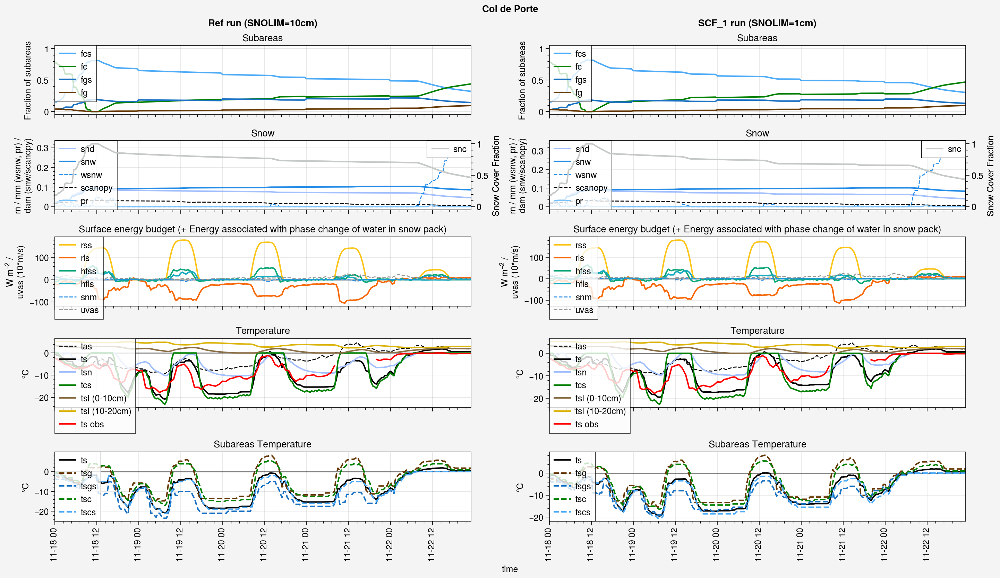

In [255]:
for period in [
    slice('1995-11-18','1995-11-22'),
]:

    fig, axs = pplt.subplots(ncols=2, nrows=5, refaspect=6, refwidth=6, sharey=0)

    for i, ds in enumerate([ds_hh, ds2_hh]):

        #############################
        ### Fractions of subareas ###
        #############################

        variables = {
            'fcs': {'color': 'blue4', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fc': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fgs': {'color': 'blue8', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fg': {'color': 'brown', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[0+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='Fraction of subareas', title='Subareas', ylim=(-0.05,1.05))

        ##############################
        ### Snow related variables ###
        ##############################

        variables = {
            'snc': {'color': 'silver', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snd': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snw': {'color': 'blue6', 'ls': '-', 'lw': 1.5, 'factor': 1e-3*10, 'shift': 0},
            'wsnw': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'scanopy': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1e-3*10, 'shift': 0},
            'pr': {'color': 'blue3', 'ls': '-', 'lw': 1, 'factor': 30, 'shift': 0},
        #     'albs': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
    #         'mrron': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        #     'snm': {'color': 'blue8', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
        }

        ax = axs[2+i]
        for key in list(variables.keys())[1:]:
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
    #     ax.plot(ds_d.vegHeight.sel(time=period).squeeze(), label=ds_d.vegHeight.name, color='green', ls='-', lw=1)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='m / mm (wsnw, pr) /\ndam (snw/scanopy)', title='Snow')
        ox = ax.alty(label='Snow Cover Fraction')
        for key in list(variables.keys())[0:1]:
            ox.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ox.legend(ncols=1, loc='ur')
        ox.format(ylim=(-0.05,1.05))


        ##############################
        ### Surface energy budget ###
        ##############################

        variables = {
            'rss': {'color': 'yellow5', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'rls': {'color': 'orange7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        #     'rlds': {'color': 'orange7', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'hfss': {'color': 'teal7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'hfls': {'color': 'cyan6', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snm': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'uvas': {'color': 'gray', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        }

        ax = axs[4+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='W m$^{-2}$ /\nuvas (10*m/s)', title='Surface energy budget (+ Energy associated with phase change of water in snow pack)')


        ###################
        ### Temperature ###
        ###################

        variables = {
            'tas': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 273.15},
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},    
            'tsn': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'tcs': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[6+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot((ds.tsl-273.15).sel(layer=1, time=period).squeeze(), label=ds.tsl.name+' (0-10cm)', color='dirt')
        ax.plot((ds.tsl-273.15).sel(layer=2, time=period).squeeze(), label=ds.tsl.name+' (10-20cm)', color='gold')
        ax.plot(ds_h_eval_menard2019.ts.sel(time=period), color='red', label='ts obs')
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Temperature')

        


        ############################
        ### Subareas Temperature ###
        ############################

        variables = {
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},

            'tsg': {'color': 'brown', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsgs': {'color': 'blue8', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsc': {'color': 'green', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tscs': {'color': 'blue4', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
        }

        ax = axs[8+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Subareas Temperature')

    fig.suptitle('Col de Porte')
    axs.format(collabels=['Ref run (SNOLIM=10cm)', 'SCF_1 run (SNOLIM=1cm)'])


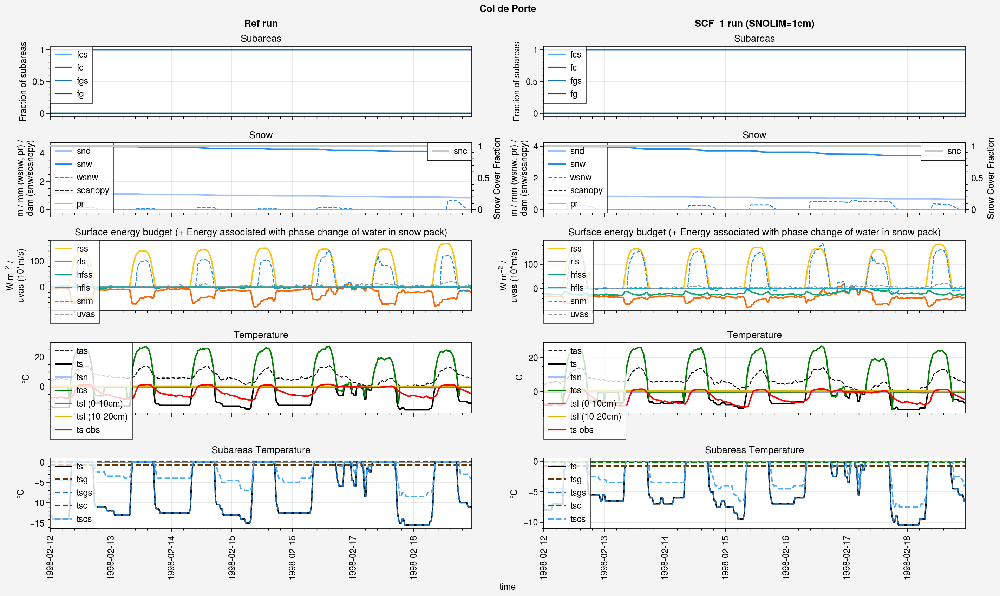

In [254]:
for period in [
    slice('1998-02-12','1998-02-18'),
]:

    fig, axs = pplt.subplots(ncols=2, nrows=5, refaspect=6, refwidth=6, sharey=0)

    for i, ds in enumerate([ds_hh, ds2_hh]):

        #############################
        ### Fractions of subareas ###
        #############################

        variables = {
            'fcs': {'color': 'blue4', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fc': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fgs': {'color': 'blue8', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fg': {'color': 'brown', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[0+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='Fraction of subareas', title='Subareas', ylim=(-0.05,1.05))

        ##############################
        ### Snow related variables ###
        ##############################

        variables = {
            'snc': {'color': 'silver', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snd': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snw': {'color': 'blue6', 'ls': '-', 'lw': 1.5, 'factor': 1e-3*10, 'shift': 0},
            'wsnw': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'scanopy': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1e-3*10, 'shift': 0},
            'pr': {'color': 'blue3', 'ls': '-', 'lw': 1, 'factor': 30, 'shift': 0},
        #     'albs': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
    #         'mrron': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        #     'snm': {'color': 'blue8', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
        }

        ax = axs[2+i]
        for key in list(variables.keys())[1:]:
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
    #     ax.plot(ds_d.vegHeight.sel(time=period).squeeze(), label=ds_d.vegHeight.name, color='green', ls='-', lw=1)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='m / mm (wsnw, pr) /\ndam (snw/scanopy)', title='Snow')
        ox = ax.alty(label='Snow Cover Fraction')
        for key in list(variables.keys())[0:1]:
            ox.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ox.legend(ncols=1, loc='ur')
        ox.format(ylim=(-0.05,1.05))


        ##############################
        ### Surface energy budget ###
        ##############################

        variables = {
            'rss': {'color': 'yellow5', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'rls': {'color': 'orange7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        #     'rlds': {'color': 'orange7', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'hfss': {'color': 'teal7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'hfls': {'color': 'cyan6', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snm': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'uvas': {'color': 'gray', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        }

        ax = axs[4+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='W m$^{-2}$ /\nuvas (10*m/s)', title='Surface energy budget (+ Energy associated with phase change of water in snow pack)')


        ###################
        ### Temperature ###
        ###################

        variables = {
            'tas': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 273.15},
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},    
            'tsn': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'tcs': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[6+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot((ds.tsl-273.15).sel(layer=1, time=period).squeeze(), label=ds.tsl.name+' (0-10cm)', color='dirt')
        ax.plot((ds.tsl-273.15).sel(layer=2, time=period).squeeze(), label=ds.tsl.name+' (10-20cm)', color='gold')
        ax.plot(ds_h_eval_menard2019.ts.sel(time=period), color='red', label='ts obs')
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Temperature')

        


        ############################
        ### Subareas Temperature ###
        ############################

        variables = {
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},

            'tsg': {'color': 'brown', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsgs': {'color': 'blue8', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsc': {'color': 'green', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tscs': {'color': 'blue4', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
        }

        ax = axs[8+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Subareas Temperature')

    fig.suptitle('Col de Porte')
    axs.format(collabels=['Ref run', 'SCF_1 run (SNOLIM=1cm)'])


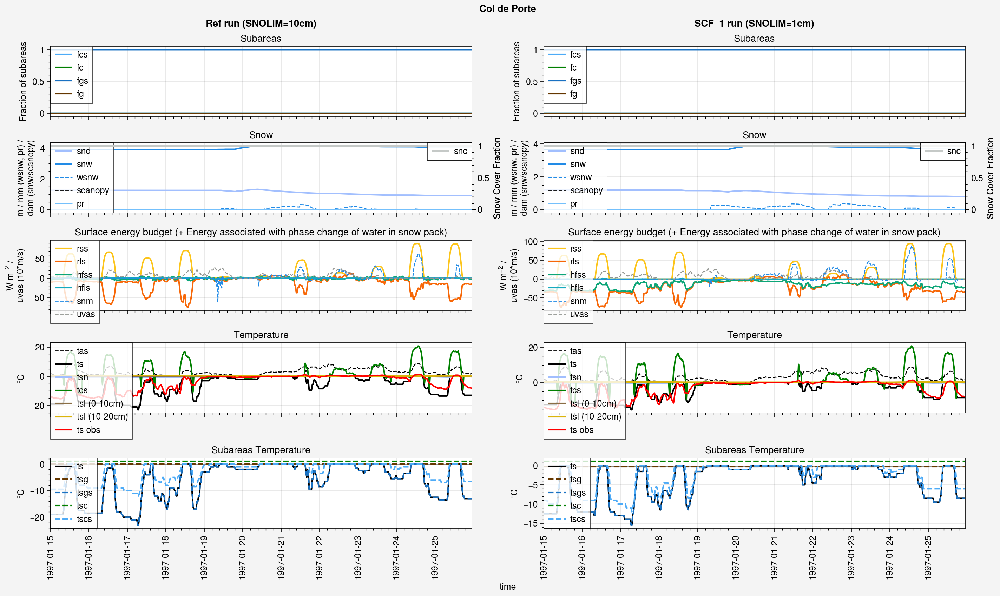

In [253]:
for period in [
    slice('1997-01-15','1997-01-25'),
]:

    fig, axs = pplt.subplots(ncols=2, nrows=5, refaspect=6, refwidth=6, sharey=0)

    for i, ds in enumerate([ds_hh, ds2_hh]):

        #############################
        ### Fractions of subareas ###
        #############################

        variables = {
            'fcs': {'color': 'blue4', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fc': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fgs': {'color': 'blue8', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fg': {'color': 'brown', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[0+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='Fraction of subareas', title='Subareas', ylim=(-0.05,1.05))

        ##############################
        ### Snow related variables ###
        ##############################

        variables = {
            'snc': {'color': 'silver', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snd': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snw': {'color': 'blue6', 'ls': '-', 'lw': 1.5, 'factor': 1e-3*10, 'shift': 0},
            'wsnw': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'scanopy': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1e-3*10, 'shift': 0},
            'pr': {'color': 'blue3', 'ls': '-', 'lw': 1, 'factor': 30, 'shift': 0},
        #     'albs': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
    #         'mrron': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        #     'snm': {'color': 'blue8', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
        }

        ax = axs[2+i]
        for key in list(variables.keys())[1:]:
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
    #     ax.plot(ds_d.vegHeight.sel(time=period).squeeze(), label=ds_d.vegHeight.name, color='green', ls='-', lw=1)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='m / mm (wsnw, pr) /\ndam (snw/scanopy)', title='Snow')
        ox = ax.alty(label='Snow Cover Fraction')
        for key in list(variables.keys())[0:1]:
            ox.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ox.legend(ncols=1, loc='ur')
        ox.format(ylim=(-0.05,1.05))


        ##############################
        ### Surface energy budget ###
        ##############################

        variables = {
            'rss': {'color': 'yellow5', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'rls': {'color': 'orange7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        #     'rlds': {'color': 'orange7', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'hfss': {'color': 'teal7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'hfls': {'color': 'cyan6', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snm': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'uvas': {'color': 'gray', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        }

        ax = axs[4+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='W m$^{-2}$ /\nuvas (10*m/s)', title='Surface energy budget (+ Energy associated with phase change of water in snow pack)')


        ###################
        ### Temperature ###
        ###################

        variables = {
            'tas': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 273.15},
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},    
            'tsn': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'tcs': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[6+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot((ds.tsl-273.15).sel(layer=1, time=period).squeeze(), label=ds.tsl.name+' (0-10cm)', color='dirt')
        ax.plot((ds.tsl-273.15).sel(layer=2, time=period).squeeze(), label=ds.tsl.name+' (10-20cm)', color='gold')
        ax.plot(ds_h_eval_menard2019.ts.sel(time=period), color='red', label='ts obs')
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Temperature')

        


        ############################
        ### Subareas Temperature ###
        ############################

        variables = {
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},

            'tsg': {'color': 'brown', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsgs': {'color': 'blue8', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsc': {'color': 'green', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tscs': {'color': 'blue4', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
        }

        ax = axs[8+i]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Subareas Temperature')

    fig.suptitle('Col de Porte')
    axs.format(collabels=['Ref run (SNOLIM=10cm)', 'SCF_1 run (SNOLIM=1cm)'])


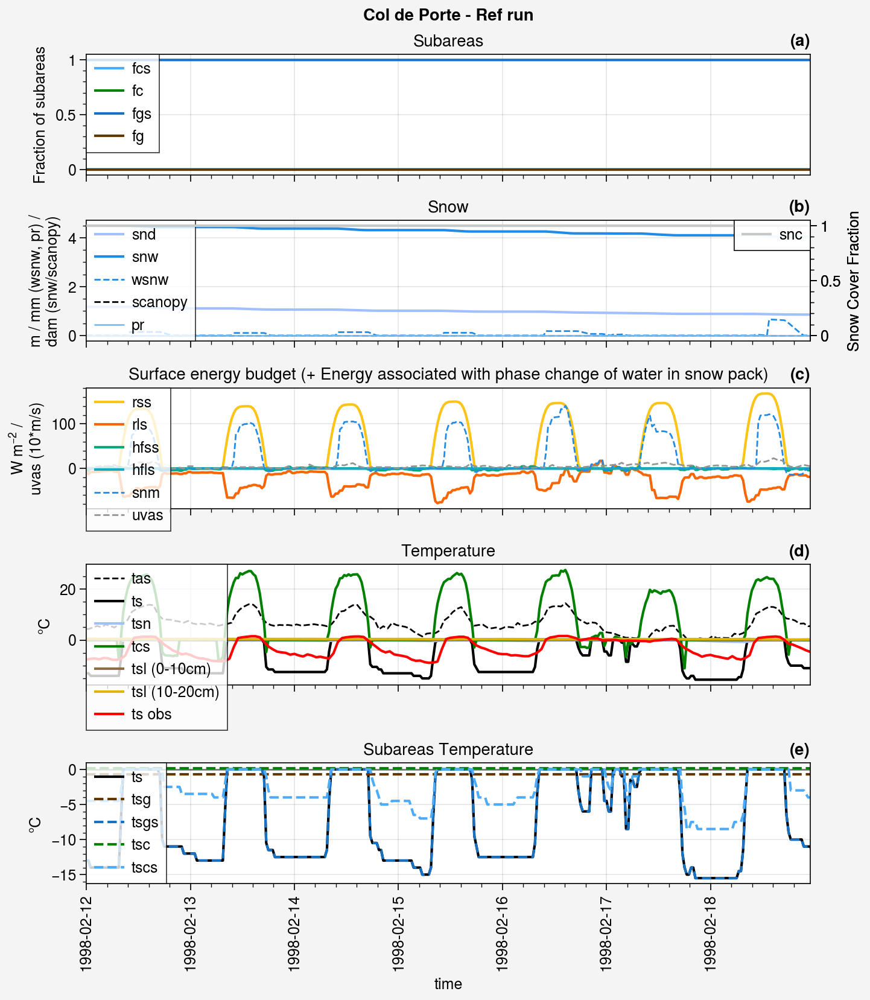

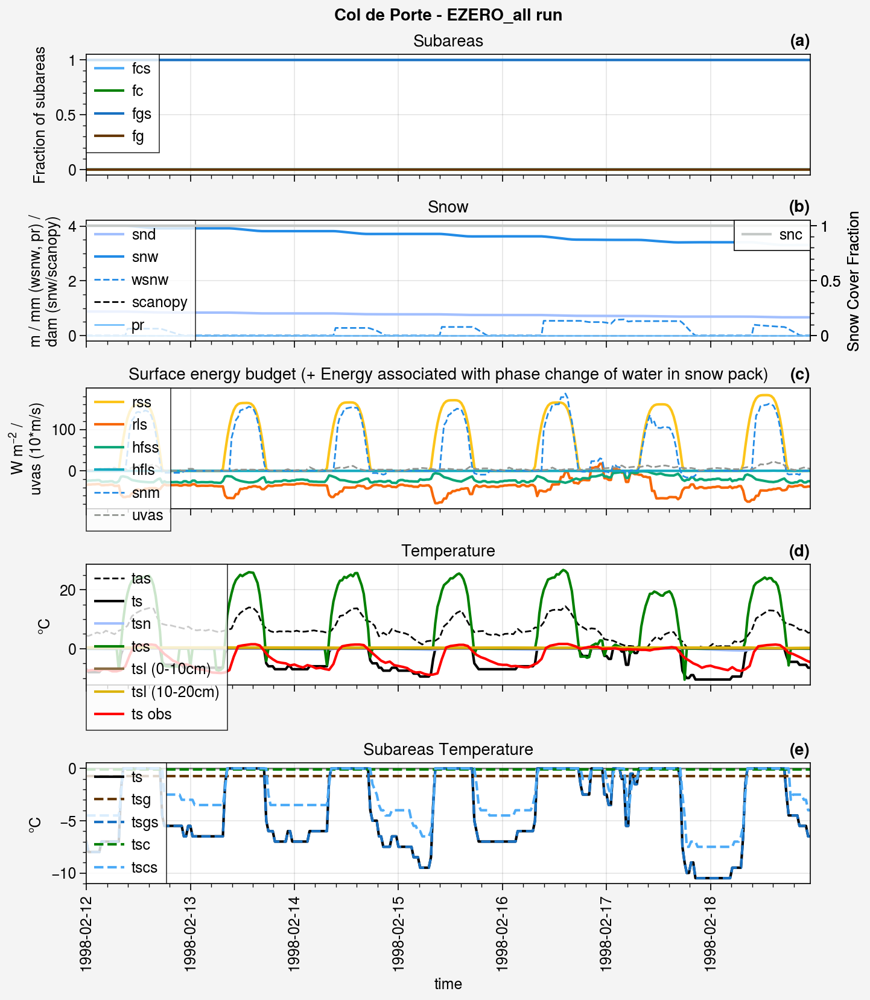

In [22]:
for period in [
    slice('1998-02-12','1998-02-18'),
]:

    collabels=['Ref run', 'EZERO_all run']
    for i, ds in enumerate([ds_hh, ds2_hh]):
        
        fig, axs = pplt.subplots(ncols=1, nrows=5, refaspect=6, refwidth=6, sharey=0)
    
        #############################
        ### Fractions of subareas ###
        #############################

        variables = {
            'fcs': {'color': 'blue4', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fc': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fgs': {'color': 'blue8', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'fg': {'color': 'brown', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[0]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='Fraction of subareas', title='Subareas', ylim=(-0.05,1.05))

        ##############################
        ### Snow related variables ###
        ##############################

        variables = {
            'snc': {'color': 'silver', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snd': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snw': {'color': 'blue6', 'ls': '-', 'lw': 1.5, 'factor': 1e-3*10, 'shift': 0},
            'wsnw': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'scanopy': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1e-3*10, 'shift': 0},
            'pr': {'color': 'blue3', 'ls': '-', 'lw': 1, 'factor': 30, 'shift': 0},
        #     'albs': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
    #         'mrron': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        #     'snm': {'color': 'blue8', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
        }

        ax = axs[1]
        for key in list(variables.keys())[1:]:
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
    #     ax.plot(ds_d.vegHeight.sel(time=period).squeeze(), label=ds_d.vegHeight.name, color='green', ls='-', lw=1)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='m / mm (wsnw, pr) /\ndam (snw/scanopy)', title='Snow')
        ox = ax.alty(label='Snow Cover Fraction')
        for key in list(variables.keys())[0:1]:
            ox.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ox.legend(ncols=1, loc='ur')
        ox.format(ylim=(-0.05,1.05))


        ##############################
        ### Surface energy budget ###
        ##############################

        variables = {
            'rss': {'color': 'yellow5', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'rls': {'color': 'orange7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        #     'rlds': {'color': 'orange7', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'hfss': {'color': 'teal7', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'hfls': {'color': 'cyan6', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'snm': {'color': 'blue6', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 0},
            'uvas': {'color': 'gray', 'ls': '--', 'lw': 1, 'factor': 10, 'shift': 0},
        }

        ax = axs[2]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='W m$^{-2}$ /\nuvas (10*m/s)', title='Surface energy budget (+ Energy associated with phase change of water in snow pack)')


        ###################
        ### Temperature ###
        ###################

        variables = {
            'tas': {'color': 'k', 'ls': '--', 'lw': 1, 'factor': 1, 'shift': 273.15},
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},    
            'tsn': {'color': 'pastel blue', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
            'tcs': {'color': 'green', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 0},
        }

        ax = axs[3]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.plot((ds.tsl-273.15).sel(layer=1, time=period).squeeze(), label=ds.tsl.name+' (0-10cm)', color='dirt')
        ax.plot((ds.tsl-273.15).sel(layer=2, time=period).squeeze(), label=ds.tsl.name+' (10-20cm)', color='gold')
        ax.plot(ds_h_eval_menard2019.ts.sel(time=period), color='red', label='ts obs')
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Temperature')

        


        ############################
        ### Subareas Temperature ###
        ############################

        variables = {
            'ts': {'color': 'k', 'ls': '-', 'lw': 1.5, 'factor': 1, 'shift': 273.15},

            'tsg': {'color': 'brown', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsgs': {'color': 'blue8', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tsc': {'color': 'green', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
            'tscs': {'color': 'blue4', 'ls': '--', 'lw': 1.5, 'factor': 1, 'shift': 273.15},
        }

        ax = axs[4]
        for key in variables.keys():
            ax.plot(((ds[key]-variables[key]['shift'])*variables[key]['factor']).sel(time=period).squeeze(), label=ds[key].name, 
                    color=variables[key]['color'], ls=variables[key]['ls'], lw=variables[key]['lw'])
        ax.hlines(0, ds.sel(time=period).squeeze().time[0], ds.sel(time=period).squeeze().time[-1], color='k', lw=1, alpha=0.5)
        ax.legend(ncols=1, loc='ul')
        ax.format(ylabel='°C', title='Subareas Temperature')

        fig.suptitle('Col de Porte - '+collabels[i])
        fig.format(abc='(a)', abcloc='r')
        fig.save('img/ezero_cdp_'+str(i)+'.jpg')